<a href="https://colab.research.google.com/github/VictorGambarini/GlobalPlastic/blob/main/GlobalPlastic_NeSI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<a href="https://colab.research.google.com/github/VictorGambarini/GlobalPlastic/blob/main/GlobalPlastic.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Description

This Colab notebook can be used to reproduce all analyses published on the article: Gambarini et al., 2022. Providing you have enough storage space to download all data on your Google Drive, all analyses should run on the cloud.

If you use it, please cite: Gambarini, V. 2022...

Contact: Victor Gambarini, victor.gambarini@gmail.com

# Initial configuration

## Install python libraries

In [ ]:
# Install conda
!pip install -q condacolab
import condacolab
condacolab.install()

⏬ Downloading https://github.com/jaimergp/miniforge/releases/latest/download/Mambaforge-colab-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:44
🔁 Restarting kernel...


In [ ]:
!pip install rasterio
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 19.3 MB 433 kB/s 
     |████████████████████████████████| 58 kB 5.9 MB/s 
     |████████████████████████████████| 15.7 MB 41.5 MB/s 
     |████████████████████████████████| 96 kB 5.4 MB/s 
     |████████████████████████████████| 98 kB 4.8 MB/s 


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     \ 21.9 MB 138 kB/s
     |████████████████████████████████| 306 kB 5.2 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
     |████████████████████████████████| 11.3 MB 32.0 MB/s 
     |████████████████████████████████| 11.2 MB 36.6 MB/s 
     |████████████████████████████████| 11.1 MB 42.8 MB/s 
     |████████████████████████████████| 596 kB 62.1 MB/s 
     |████████████████████████████████| 133 kB 62.2 MB/s 
     |████████████████████████████████| 102 kB 60.3 MB/s 
     |████████████████████████████████| 690 kB 52.8 MB/s 
     |████████████████████████████████| 4.7 MB 57.5 MB/s 
     |████████████████████████████████| 292 kB 57.7 MB/s 
     |████████████████████████████████| 1.9 MB 44.7 MB/s 
     |████████████████████████████████| 3.1 MB 48.0 MB/s 
     |████████████████████████████████| 812 kB 53.2 MB/s 
     |████████████████████████████████| 40 kB 5.4 MB/s 
     |█

## Import python libraries

In [ ]:
%matplotlib inline

from google.colab import drive
import pandas as pd
import numpy as np
import os
import folium
import hashlib
import time
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport

# Geospatial data and map libraries
import rasterio
from rasterio.plot import show
from folium.plugins import HeatMap
import branca
import branca.colormap as cm

## Google Drive

In [ ]:
#@markdown If you want all files to be saved to a folder on your Google Drive,
#@markdown insert a path from your Google Drive where to save it. A pop-up for
#@markdown authentication will appear. If it works, all files inside that folder
#@markdown will be listed.

folder = 'Victor/PhD/Victor/Component_5/' #@param {type:"string"}
path = "/content/drive/MyDrive/"+folder
drive.mount('/content/drive', force_remount=True)
!mkdir {path+"tools"}
!mkdir {path+"metatranscriptomic_data"}
!mkdir {path+"metagenomic_data"}
!mkdir {path+"metataxonomic_data"}
!mkdir {path+"global_plastic_count"}
!mkdir {path+"databases"}
!mkdir {path+"databases/PlasticDB"}
!mkdir {path+"databases/nr"}
!mkdir {path+"databases/megan_mapping"}
!mkdir {path+"figures"}
!ls {path}

Mounted at /content/drive
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/tools’: File exists
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/metatranscriptomic_data’: File exists
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/metagenomic_data’: File exists
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/metataxonomic_data’: File exists
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/global_plastic_count’: File exists
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases’: File exists
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases/PlasticDB’: File exists
mkdir: cannot create directory ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases/nr’: File exists
mkdir: cannot create directory ‘/content/drive/MyDri

## Slurm options

In [ ]:
#If running on a Slurm cluster, change account name and change run_on_slurm variable to True.
account = "uoa02642"
run_on_slurm = True

In [ ]:
# Function to submit jobs on Slurm
def run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command):
    if run_on_slurm == False:
        os.system(job_command)
    if run_on_slurm == True:
        f = open("run.sh", "w")
        f.write("""#!/bin/bash

#SBATCH --account="""+str(account)+"""
#SBATCH --job-name="""+str(job_name)+"""
#SBATCH --time="""+str(job_time)+"""
#SBATCH --mem="""+str(job_memory)+"""
#SBATCH --cpus-per-task="""+str(job_cpus)+"""

module load Python/3.7.3-gimkl-2018b
module load BLAST


"""+job_command)
        f.close()

        os.system("sbatch run.sh")
        os.system("rm run.sh")
    else:
        print("Please, set 'run_on_slurm' variable to True or False")



## Miscelaneous functions

In [ ]:
# Function to check file md5
def check_md5(file, original_md5, blocksize=2*10**9):
  if os.path.exists(file) == True:
    print("Checking md5 of file ", file)
    md5_returned = hashlib.md5()
    with open(file, 'rb') as f:
        while True:
            buf = f.read(blocksize)
            if not buf:
                break
            md5_returned.update(buf)
    md5_returned = md5_returned.hexdigest()

    if original_md5 == md5_returned:
        return True
    else:
        return False
  else:
    return False

# Function to create a directory
def create_directory(directory_name):
    if os.path.exists(directory_name) == False:
        os.mkdir(directory_name)

# Function to check if another function returns an error
def is_error(func, *args, **kw):
    try:
        func(*args, **kw)
        return False
    except Exception:
        return True

# Downloading data

## Download bioinformatics tools

In [ ]:
# Download diamond aligner
!wget https://raw.githubusercontent.com/VictorGambarini/GlobalPlastic/main/diamond -O {path+"tools/"}diamond
!chmod 777 {path+"tools/"}diamond
!{path+"tools/"}diamond help

--2022-06-21 02:41:50--  https://raw.githubusercontent.com/VictorGambarini/GlobalPlastic/main/diamond
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14488976 (14M) [application/octet-stream]
Saving to: ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/tools/diamond’

/content/drive/MyDr 100%[===================>]  13.82M  41.8MB/s    in 0.3s    

2022-06-21 02:41:51 (41.8 MB/s) - ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/tools/diamond’ saved [14488976/14488976]

diamond v2.0.6.144 (C) Max Planck Society for the Advancement of Science
Documentation, support and updates available at http://www.diamondsearch.org

Syntax: diamond COMMAND [OPTIONS]

Commands:
makedb	Build DIAMOND database from a FASTA file
blastp	Align amino acid query sequences 

In [ ]:
# Function to split plastics in df
def split_plastics(s):
    return s.split("||")[3].split("_")

def merge_lists(l):
  new_l = []
  for item in l:
    new_l += l
  return set(new_l)

# Function to parse diamond results
def parse_diamond(sample, r1, r2, evalue, pident, PlasticDB_plastics):
  columns = ["qseqid", "sseqid", "pident", "length", "mismatch", "gapopen", "qstart", "qend", "sstart", "send", "evalue", "bitscore"]
  results_dict = {i: 0 for i in PlasticDB_plastics}
  df1 = pd.read_csv(r1, sep="\t", names=columns, skiprows = 3)
  df2 = pd.read_csv(r2, sep="\t", names=columns, skiprows = 3)
  df = pd.concat([df1, df2])
  df = df.query("evalue <= evalue and pident >= pident")
  df = df[(df['evalue'] <= evalue) & (df['pident'] >= pident)]
  df["plastics"] = df["sseqid"].apply(split_plastics)
  df = df.groupby(["qseqid"], as_index=False)["plastics"].sum()
  df["plastics"] = df["plastics"].apply(set)
  for index, row in df.iterrows():
    for item in row["plastics"]:
      results_dict[item] += 1
  return pd.DataFrame([results_dict], index=[sample])

In [ ]:
# Download MEGAN
!conda install -c bioconda megan

Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / failed with initial frozen solve. Retrying with flexible solve.
Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ done
Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | done

## Package Plan ##

  environment location: /usr/local

  added / updated specs:
    - megan


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-

## Download sequencing data

### Metatranscriptomic data

In [ ]:
# Load file downloaded from ENA with information on samples and ftp addresses
# It contains all samples found on 23/05/2022 on the accession numbers PRJEB6608 and PRJEB9741
url = "https://raw.githubusercontent.com/VictorGambarini/GlobalPlastic/main/ENA_metatranscriptomes.txt"
Metatranscriptomic_ENA = pd.read_csv(url, sep="\t", index_col=0)
Metatranscriptomic_ENA

,study_accession,secondary_study_accession,sample_accession,secondary_sample_accession,experiment_accession,run_accession,submission_accession,tax_id,scientific_name,instrument_platform,...,sra_aspera,sra_galaxy,cram_index_ftp,cram_index_aspera,cram_index_galaxy,sample_alias,broker_name,sample_title,nominal_sdev,first_created
0,PRJEB6608,ERP006155,SAMEA2621198,ERS490542,ERX1080650,ERR1001626,ERA475773,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR100/006/ERR100...,ftp.sra.ebi.ac.uk/vol1/err/ERR100/006/ERR1001626,NaN,NaN,NaN,TARA_B100000513,NaN,TARA_20101016T0955Z_076_EVENT_PUMP_P_S_(5 m)_B...,0,4/09/2015
1,PRJEB6608,ERP006155,SAMEA2621254,ERS490659,ERX1080651,ERR1001627,ERA475773,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR100/007/ERR100...,ftp.sra.ebi.ac.uk/vol1/err/ERR100/007/ERR1001627,NaN,NaN,NaN,TARA_B100000524,NaN,TARA_20101104T1004Z_078_EVENT_PUMP_P_S_(5 m)_B...,0,4/09/2015
2,PRJEB6608,ERP006155,SAMEA2623850,ERS494518,ERX1399744,ERR1328122,ERA582742,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR132/002/ERR132...,ftp.sra.ebi.ac.uk/vol1/err/ERR132/002/ERR1328122,NaN,NaN,NaN,TARA_B100001564,NaN,TARA_20120309T0859Z_151_EVENT_PUMP_P_S_(5 m)_B...,0,16/03/2016
3,PRJEB6608,ERP006155,SAMEA2620085,ERS488920,ERX1399743,ERR1328123,ERA582742,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR132/003/ERR132...,ftp.sra.ebi.ac.uk/vol1/err/ERR132/003/ERR1328123,NaN,NaN,NaN,TARA_B100000091,NaN,TARA_20100318T1133Z_039_EVENT_PUMP_P_D_(25 m)_...,0,16/03/2016
4,PRJEB6608,ERP006155,SAMEA2620085,ERS488920,ERX1399742,ERR1328124,ERA582742,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR132/004/ERR132...,ftp.sra.ebi.ac.uk/vol1/err/ERR132/004/ERR1328124,NaN,NaN,NaN,TARA_B100000091,NaN,TARA_20100318T1133Z_039_EVENT_PUMP_P_D_(25 m)_...,0,16/03/2016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
534,PRJEB9741,ERP010881,SAMEA4398105,ERS1309554,ERX3582686,ERR3586746,ERA2161151,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/006/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/006/ERR3586746,NaN,NaN,NaN,TARA_B110000875,NaN,TARA_20131008T1215Z_205_EVENT_PUMP_SRF_(5m)_SE...,0,9/10/2019
535,PRJEB9741,ERP010881,SAMEA4397085,ERS1308534,ERX3582687,ERR3586747,ERA2161151,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/007/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/007/ERR3586747,NaN,NaN,NaN,TARA_B110000200,NaN,TARA_20130610T0838Z_163_Combined-EVENTS_CAST_M...,0,9/10/2019
536,PRJEB9741,ERP010881,SAMEA4397112,ERS1308561,ERX3582688,ERR3586748,ERA2161151,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/008/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/008/ERR3586748,NaN,NaN,NaN,TARA_B110000023,NaN,TARA_20130701T0320Z_168_EVENT_PUMP_SRF_(5m)_SE...,0,9/10/2019
537,PRJEB9741,ERP010881,SAMEA4397209,ERS1308658,ERX3582689,ERR3586749,ERA2161151,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/009/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/009/ERR3586749,NaN,NaN,NaN,TARA_B110000035,NaN,TARA_20130702T0424Z_168_Combined-EVENTS_CAST_M...,0,9/10/2019


In [ ]:
# Create a file to store ids of samples that have been downloaded and checked
!touch {path+"metatranscriptomic_data/downloads.tsv"}

# Download FASTQ files from ENA
with open(path+"metatranscriptomic_data/downloads.tsv", "r") as f:
  downloaded_samples = f.read().rstrip()
for index, row in Metatranscriptomic_ENA.iterrows():
    url1, url2 = row["fastq_ftp"].split(";")
    r1 = path+"metatranscriptomic_data/"+url1.split("/")[-1]
    r2 = path+"metatranscriptomic_data/"+url2.split("/")[-1]
    sample = r1.split("/")[-1].split("_")[0]
    if sample not in downloaded_samples:
      md5_1, md5_2 = row["fastq_md5"].split(";")
      while check_md5(r1, md5_1) == False:
        print("Downloading file "+r1.split("/")[-1]+"...")
        !wget -q ftp://{url1} -O {r1} -q
      while check_md5(r2, md5_2) == False:
        print("Downloading file "+r2.split("/")[-1]+"...")
        !wget -q ftp://{url2} -O {r2} -q
      print("Downloaded files for sample "+str(index)+", "+sample)
      with open(path+"metatranscriptomic_data/downloads.tsv", "a") as f:
        f.write(sample+"\n")

^C
Checking md5 of file  /content/drive/MyDrive/Victor/PhD/Victor/Component_5/metatranscriptomic_data/ERR1001626_1.fastq.gz


KeyboardInterrupt: ignored

### Metagenomic data

In [ ]:
# Load file downloaded from ENA with information on samples and ftp addresses.
# It contains all samples found on 23/05/2022 on the accession numbers PRJEB1787 and PRJEB9740
url = "https://raw.githubusercontent.com/VictorGambarini/GlobalPlastic/main/ENA_metagenomes.txt"
Metagenomic_ENA = pd.read_csv(url, sep="\t", index_col=0)
Metagenomic_ENA

,study_accession,secondary_study_accession,sample_accession,secondary_sample_accession,experiment_accession,run_accession,submission_accession,tax_id,scientific_name,instrument_platform,...,sra_aspera,sra_galaxy,cram_index_ftp,cram_index_aspera,cram_index_galaxy,sample_alias,broker_name,sample_title,nominal_sdev,first_created
3,PRJEB1787,ERP001736,SAMEA2620084,ERS488919,ERX1772048,ERR1701760,ERA740434,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR170/000/ERR170...,ftp.sra.ebi.ac.uk/vol1/err/ERR170/000/ERR1701760,NaN,NaN,NaN,TARA_B100000105,NaN,TARA_20100318T1133Z_039_EVENT_PUMP_P_D_(25 m)_...,0.0,2016-10-24
4,PRJEB1787,ERP001736,SAMEA2591084,ERS477979,ERX289007,ERR315858,ERA242034,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315858,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315858,NaN,NaN,NaN,TARA_E500000075,NaN,TARA_20091118T0841Z_023_EVENT_PUMP_P_S_(5-7m)_...,0.0,2013-07-19
5,PRJEB1787,ERP001736,SAMEA2591098,ERS477998,ERX289006,ERR315859,ERA242034,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315859,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315859,NaN,NaN,NaN,TARA_E500000081,NaN,TARA_20091118T1240Z_023_EVENT_PUMP_P_D_(55-57m...,0.0,2013-07-19
6,PRJEB1787,ERP001736,SAMEA2591098,ERS477998,ERX289008,ERR315860,ERA242034,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315860,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315860,NaN,NaN,NaN,TARA_E500000081,NaN,TARA_20091118T1240Z_023_EVENT_PUMP_P_D_(55-57m...,0.0,2013-07-19
7,PRJEB1787,ERP001736,SAMEA2591084,ERS477979,ERX289009,ERR315861,ERA242034,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315861,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315861,NaN,NaN,NaN,TARA_E500000075,NaN,TARA_20091118T0841Z_023_EVENT_PUMP_P_S_(5-7m)_...,0.0,2013-07-19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
285,PRJEB9740,ERP010880,SAMEA4397390,ERS1308839,ERX3585476,ERR3589589,ERA2164763,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/009/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/009/ERR3589589,NaN,NaN,NaN,TARA_B110000093,NaN,TARA_20130711T0613Z_175_Combined-EVENTS_CAST_M...,0.0,2019-10-14
286,PRJEB9740,ERP010880,SAMEA4397426,ERS1308875,ERX3585477,ERR3589590,ERA2164763,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/000/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/000/ERR3589590,NaN,NaN,NaN,TARA_B110000208,NaN,TARA_20130715T0211Z_178_EVENT_PUMP_SRF_(5m)_SE...,0.0,2019-10-14
287,PRJEB9740,ERP010880,SAMEA4396424,ERS1307873,ERX3585478,ERR3589591,ERA2164763,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/001/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/001/ERR3589591,NaN,NaN,NaN,TARA_B110000003,NaN,TARA_20130524T0536Z_155_EVENT_PUMP_SRF_(5m)_SE...,0.0,2019-10-14
288,PRJEB9740,ERP010880,SAMEA4396538,ERS1307987,ERX3585479,ERR3589592,ERA2164763,408172,marine metagenome,ILLUMINA,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR358/002/ERR358...,ftp.sra.ebi.ac.uk/vol1/err/ERR358/002/ERR3589592,NaN,NaN,NaN,TARA_B110001450,NaN,TARA_20130603T0731Z_158_EVENT_PUMP_SRF_(5m)_SE...,0.0,2019-10-14


In [ ]:
# Create a file to store ids of samples that have been downloaded and checked
!touch {path+"metagenomic_data/downloads.tsv"}

# Download FASTQ files from ENA
with open(path+"metagenomic_data/downloads.tsv", "r") as f:
  downloaded_samples = f.read().rstrip()
for index, row in Metagenomic_ENA.iterrows():
    url1, url2 = row["fastq_ftp"].split(";")
    r1 = path+"metagenomic_data/"+url1.split("/")[-1]
    r2 = path+"metagenomic_data/"+url2.split("/")[-1]
    sample = r1.split("/")[-1].split("_")[0]
    if sample not in downloaded_samples:
      md5_1, md5_2 = row["fastq_md5"].split(";")
      while check_md5(r1, md5_1) == False:
        print("Downloading file "+r1.split("/")[-1]+"...")
        !wget -q ftp://{url1} -O {r1} -q
      while check_md5(r2, md5_2) == False:
        print("Downloading file "+r2.split("/")[-1]+"...")
        !wget -q ftp://{url2} -O {r2} -q
      print("Downloaded files for sample "+str(index)+", "+sample)
      with open(path+"metagenomic_data/downloads.tsv", "a") as f:
        f.write(sample+"\n")

### Metataxonomic data

In [ ]:
# Load file downloaded from ENA with information on samples and ftp addresses
# It contains all samples found on 23/05/2022 on the accession numbers PRJEB36282, PRJEB36283 and PRJEB4357
url = "https://raw.githubusercontent.com/VictorGambarini/GlobalPlastic/main/ENA_amplicon.txt"
Metataxonomic_ENA = pd.read_csv(url, sep="\t", index_col=0)
Metataxonomic_ENA

,study_accession,secondary_study_accession,sample_accession,secondary_sample_accession,experiment_accession,run_accession,submission_accession,tax_id,scientific_name,instrument_platform,...,sra_aspera,sra_galaxy,cram_index_ftp,cram_index_aspera,cram_index_galaxy,sample_alias,broker_name,sample_title,nominal_sdev,first_created
0,PRJEB36282,ERP119447,SAMEA2619376,ERS487899,ERX5728778,ERR6090675,ERA4897885,408172,marine metagenome,ILLUMINA,...,NaN,NaN,NaN,NaN,NaN,TARA_X000000263,NaN,TARA_20090915T1130Z_004_EVENT_PUMP_P_S_(5 m)_B...,0.0,2021-06-18
1,PRJEB36282,ERP119447,SAMEA2619376,ERS487899,ERX5728779,ERR6090676,ERA4897885,408172,marine metagenome,ILLUMINA,...,NaN,NaN,NaN,NaN,NaN,TARA_X000000263,NaN,TARA_20090915T1130Z_004_EVENT_PUMP_P_S_(5 m)_B...,0.0,2021-06-18
2,PRJEB36282,ERP119447,SAMEA2619667,ERS488330,ERX5728780,ERR6090677,ERA4897885,408172,marine metagenome,ILLUMINA,...,NaN,NaN,NaN,NaN,NaN,TARA_A100000164,NaN,TARA_20091102T0813Z_018_EVENT_PUMP_P_S_(5 m)_B...,0.0,2021-06-18
3,PRJEB36282,ERP119447,SAMEA2619667,ERS488330,ERX5728781,ERR6090678,ERA4897885,408172,marine metagenome,ILLUMINA,...,NaN,NaN,NaN,NaN,NaN,TARA_A100000164,NaN,TARA_20091102T0813Z_018_EVENT_PUMP_P_S_(5 m)_B...,0.0,2021-06-18
4,PRJEB36282,ERP119447,SAMEA2619766,ERS488486,ERX5728782,ERR6090679,ERA4897885,408172,marine metagenome,ILLUMINA,...,NaN,NaN,NaN,NaN,NaN,TARA_E500000178,NaN,TARA_20091123T0912Z_025_EVENT_PUMP_P_S_(5 m)_B...,0.0,2021-06-18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,PRJEB4357,ERP003634,SAMEA2591109,ERS478018,ERX289001,ERR315851,ERA242032,408172,marine metagenome,LS454,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315851,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315851,NaN,NaN,NaN,TARA_A100001016,NaN,TARA_20091215T1041Z_030_EVENT_PUMP_P_S_(5-7m)_...,NaN,2013-07-19
140,PRJEB4357,ERP003634,SAMEA2591099,ERS477999,ERX289000,ERR315852,ERA242032,408172,marine metagenome,LS454,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315852,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315852,NaN,NaN,NaN,TARA_E500000080,NaN,TARA_20091118T1240Z_023_EVENT_PUMP_P_D_(55-57m...,NaN,2013-07-19
141,PRJEB4357,ERP003634,SAMEA2591084,ERS477979,ERX289003,ERR315853,ERA242032,408172,marine metagenome,LS454,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315853,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315853,NaN,NaN,NaN,TARA_E500000075,NaN,TARA_20091118T0841Z_023_EVENT_PUMP_P_S_(5-7m)_...,NaN,2013-07-19
142,PRJEB4357,ERP003634,SAMEA2591051,ERS477925,ERX289002,ERR315854,ERA242032,408172,marine metagenome,LS454,...,fasp.sra.ebi.ac.uk:/vol1/err/ERR315/ERR315854,ftp.sra.ebi.ac.uk/vol1/err/ERR315/ERR315854,NaN,NaN,NaN,TARA_A200000114,NaN,TARA_20090923T1250Z_007_EVENT_PUMP_P_S_(5-7m)_...,NaN,2013-07-19


In [ ]:
# Create a file to store ids of samples that have been downloaded and checked
!touch {path+"metataxonomic_data/downloads.tsv"}

# Download FASTQ files from ENA
with open(path+"metataxonomic_data/downloads.tsv", "r") as f:
  downloaded_samples = f.read().rstrip()
for index, row in Metataxonomic_ENA.iterrows():
    url1, url2 = row["fastq_ftp"].split(";")
    r1 = path+"metataxonomic_data/"+url1.split("/")[-1]
    r2 = path+"metataxonomic_data/"+url2.split("/")[-1]
    sample = r1.split("/")[-1].split("_")[0]
    if sample not in downloaded_samples:
      md5_1, md5_2 = row["fastq_md5"].split(";")
      while check_md5(r1, md5_1) == False:
        print("Downloading file "+r1.split("/")[-1]+"...")
        !wget -q ftp://{url1} -O {r1} -q
      while check_md5(r2, md5_2) == False:
        print("Downloading file "+r2.split("/")[-1]+"...")
        !wget -q ftp://{url2} -O {r2} -q
      print("Downloaded files for sample "+str(index)+", "+sample)
      with open(path+"metataxonomic_data/downloads.tsv", "a") as f:
        f.write(sample+"\n")

## Download plastic pollution data

In [ ]:
# Download dataset from
# !wget https://www.dropbox.com/s/1oyysnudvx5fdm8/count_density_size1_360.tif?dl=0 -O {path+"global_plastic_count/count_density_size1_360.tif"}
img = rasterio.open(path+"global_plastic_count/count_density_size1_360.tif")
img.profile

{'driver': 'GTiff', 'dtype': 'float64', 'nodata': None, 'width': 1801, 'height': 901, 'count': 1, 'crs': CRS.from_epsg(4326), 'transform': Affine(0.19988895058300943, 0.0, 0.0,
       0.0, -0.1997780244173141, 90.0), 'blockxsize': 192, 'blockysize': 96, 'tiled': True, 'compress': 'packbits', 'interleave': 'band'}

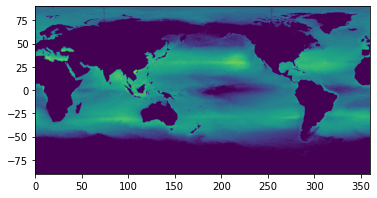

In [ ]:
# Show image with heatmap of plastic pollution in the oceans
show(img)

In [ ]:
# Create a list with latitude, longitude, and plastic count data
band_id = 1
band_arr = img.read(band_id)
geo_list = []

for y in range(band_arr.shape[0]):
    for x in range(band_arr.shape[1]):
      if x > 900:
        lon = x * 0.2 - 360
      else:
        lon = x * 0.2
      lat = -1 * y * 0.2 + 90
      geo_list.append({'x': x,
                      'y': y,
                      'count': band_arr[y, x],
                      'lon': lon,
                      'lat': lat
                      })

col = ["x", "y", "lon", "lat", "count"]
geo_df = pd.DataFrame(geo_list, columns=col)
geo_df

,x,y,lon,lat,count
0,0,0,0.0,90.0,0.230901
1,1,0,0.2,90.0,0.230901
2,2,0,0.4,90.0,0.230901
3,3,0,0.6,90.0,0.230901
4,4,0,0.8,90.0,0.230901
...,...,...,...,...,...
1622696,1796,900,-0.8,-90.0,0.230901
1622697,1797,900,-0.6,-90.0,0.230901
1622698,1798,900,-0.4,-90.0,0.230901
1622699,1799,900,-0.2,-90.0,0.230901


In [ ]:
# To confirm that the data has been imported correctly, I will plot a heatmap
# of plastic counts in a smaller region and compare to initial image. I will
# make a rectangle from latitude -50 to 50 and longitude -180 to -80

geo_df_test = geo_df[(geo_df.lat > -50) & (geo_df.lat < 50) & (geo_df.lon > -180) & (geo_df.lon < 180)]
geo_df_test = geo_df_test.sample(n=10000)
geo_df_test

# Define color gradient
colormap = cm.LinearColormap(colors=['green', 'gray', 'red'],
                             vmin=geo_df_test["count"].min(),
                             vmax=geo_df_test["count"].max(),)

# Make an empty map
m = folium.Map(location=[20,0], tiles="OpenStreetMap", zoom_start=2)

# I can add marker one by one on the map
for index, row in geo_df_test.iterrows():
    folium.Circle(location=[row["lat"], row["lon"]],
                  radius=1000,
                  popup=str(row["lat"])+str(row["lon"]),
                  color=colormap(row["count"]),
                  fill=True,
                  opacity=1,
                  fill_opacity=1,
                  fill_color=colormap(row["count"])
                  ).add_to(m)

# # Save it as html
# m.save('mymap.html')
m

## Download environmental variables data

In [ ]:
# Load environmental variables
# Original files were downloaded from https://doi.pangaea.de/10.1594/PANGAEA.875582

# ! wget https://www.dropbox.com/s/4yy5ihp2fsfw9ao/TARA_SAMPLES_CONTEXT_ENV-WATERCOLUMN.tsv?dl=0 -O {path}Metatranscriptomic_environmental.tsv
df_env = pd.read_csv(path+"Metatranscriptomic_environmental.tsv", sep="\t", index_col=0, skiprows = 1, error_bad_lines=False)
df_env

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version.


  exec(code_obj, self.user_global_ns, self.user_ns)


,Sample ID (BioSamples accession number (...),Sample ID (ENA sample accession number (...),Basis,Campaign,"Station (TARA_station#, registered at ...)",Method/Device,Event,Date/Time,Latitude,Longitude,...,u [cm/s] (at the sampling location and ...),v [cm/s] (at the sampling location and ...),OW (at the sampling location and ...),MLE [1/day] (at the sampling location and ...),RT [days] (of the water mass at the samp...),Latitude (of the continental shelf with...),Longitude (of the continental shelf with...),Age [days] (number of days since the samp...),Latitude (of the geographic coordinate ...),Longitude (of the geographic coordinate ...)
"Sample ID (TARA_barcode#, registered at ...)",,,,,,,,,,,,,,,,,,,,,
TARA_X000000174,SAMEA4402502,ERS1313951,SV Tara,TARA_20090905Z,TARA_001,"Plankton net, type=Bongo, mesh(µm)=300, mouth(...",TARA_20090907T1530Z_001_EVENT_NET,2009-09-07T15:30,44.4013,-9.8273,...,-3.855836,-8.864694,-0.119940,0.075851,10.972222,NaN,NaN,120.0,44.482973,-10.348751
TARA_X000000173,SAMEA4402503,ERS1313952,SV Tara,TARA_20090905Z,TARA_001,"Plankton net+sieve, type=Double, mesh(µm)=20, ...",TARA_20090907T1610Z_001_EVENT_NET,2009-09-07T16:10,44.4013,-9.8273,...,-3.855836,-8.864694,-0.119940,0.075851,10.972222,NaN,NaN,120.0,44.482973,-10.348751
TARA_X000000172,SAMEA4402504,ERS1313953,SV Tara,TARA_20090905Z,TARA_002,"Plankton net, type=Regent, mesh(µm)=680, mouth...",TARA_20090909T1830Z_002_EVENT_NET,2009-09-09T18:30,39.0564,-10.9808,...,-0.631608,-0.773749,-0.006249,0.044172,2.916667,NaN,NaN,120.0,40.591896,-10.146312
TARA_X000000171,SAMEA4402505,ERS1313954,SV Tara,TARA_20090913Z,TARA_003,"Plankton net, type=Bongo, mesh(µm)=300, mouth(...",TARA_20090913T1130Z_003_EVENT_NET,2009-09-13T11:30,36.7320,-10.4750,...,-3.196994,6.553035,-0.127186,0.062208,25.638889,NaN,NaN,120.0,NaN,NaN
TARA_X000000180,none,none,SV Tara,TARA_20090913Z,TARA_003,High Volume Peristaltic Pump,TARA_20090913T1200Z_003_EVENT_PUMP,2009-09-13T12:00,36.7320,-10.4750,...,-3.196994,6.553035,-0.127186,0.062208,25.638889,NaN,NaN,120.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TARA_B010001151,SAMEA4425728,ERS1337177,SV Tara,TARA_20131116Z,TARA_999,Continuous Surface Sampling System,TARA_20131205T1323Z_999_EVENT_CSSS,2013-12-05T13:23,48.6007,-9.0989,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TARA_G100017759,SAMEA4425729,ERS1337178,SV Tara,TARA_20131116Z,TARA_999,Continuous Surface Sampling System,TARA_20131205T1323Z_999_EVENT_CSSS,2013-12-05T13:23,48.6007,-9.0989,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TARA_R010000733,none,none,SV Tara,TARA_20131116Z,TARA_999,Continuous Surface Sampling System,TARA_20131206T0821Z_999_EVENT_CSSS,2013-12-06T08:21,48.2609,-5.1184,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Get sample ids into env df by using "sample_alias" collumn

# Create a df with all column names from Metatranscriptomic_env
columns = df_env.columns.to_list()
df = pd.DataFrame(columns = columns)

# Create a dict with the mappings of run_accession to sample_alias
Metatranscriptomic_samples_dic = {}
for index, row in Metatranscriptomic_ENA.iterrows():
  Metatranscriptomic_samples_dic[row["run_accession"]] = row["sample_alias"]
Metagenomic_samples_dic = {}
for index, row in Metagenomic_ENA.iterrows():
  Metagenomic_samples_dic[row["run_accession"]] = row["sample_alias"]
Metataxonomic_samples_dic = {}
for index, row in Metataxonomic_ENA.iterrows():
  Metataxonomic_samples_dic[row["run_accession"]] = row["sample_alias"]

# Iterate over dict and find metadata on df
for key, value in Metatranscriptomic_samples_dic.items():
  df.loc[key] = df_env.loc[value].to_list()
for key, value in Metagenomic_samples_dic.items():
  df.loc[key] = df_env.loc[value].to_list()
for key, value in Metataxonomic_samples_dic.items():
  df.loc[key] = df_env.loc[value].to_list()

df_env = df.copy()
df_env

,Sample ID (BioSamples accession number (...),Sample ID (ENA sample accession number (...),Basis,Campaign,"Station (TARA_station#, registered at ...)",Method/Device,Event,Date/Time,Latitude,Longitude,...,u [cm/s] (at the sampling location and ...),v [cm/s] (at the sampling location and ...),OW (at the sampling location and ...),MLE [1/day] (at the sampling location and ...),RT [days] (of the water mass at the samp...),Latitude (of the continental shelf with...),Longitude (of the continental shelf with...),Age [days] (number of days since the samp...),Latitude (of the geographic coordinate ...),Longitude (of the geographic coordinate ...)
ERR1001626,SAMEA2621198,ERS490542,SV Tara,TARA_20101003Z,TARA_076,High Volume Peristaltic Pump,TARA_20101016T0955Z_076_EVENT_PUMP,2010-10-16T09:55,-20.9354,-35.1803,...,0.479170,2.691546,0.084131,0.027592,0.000000,NaN,NaN,120.0,-21.599961,-34.642670
ERR1001627,SAMEA2621254,ERS490659,SV Tara,TARA_20101031Z,TARA_078,High Volume Peristaltic Pump,TARA_20101104T1015Z_078_EVENT_PUMP,2010-11-04T10:24,-30.1367,-43.2899,...,8.645021,-6.421140,0.053558,0.148190,5.777778,-41.647227,-23.741772,68.0,-24.631241,-42.963714
ERR1328122,SAMEA2623850,ERS494518,SV Tara,TARA_20120223Z,TARA_151,High Volume Peristaltic Pump,TARA_20120309T0859Z_151_EVENT_PUMP,2012-03-09T08:59,36.1715,-29.0230,...,-4.997032,3.058714,-0.157861,0.025897,37.583333,-28.188777,38.652506,76.0,36.954407,-27.865133
ERR1328123,SAMEA2620085,ERS488920,SV Tara,TARA_20100309Z,TARA_039,High Volume Peristaltic Pump,TARA_20100318T1133Z_039_EVENT_PUMP,2010-03-18T11:33,18.5839,66.4727,...,-0.557961,15.046586,0.403157,NaN,2.250000,NaN,NaN,120.0,16.583327,63.625415
ERR1328124,SAMEA2620085,ERS488920,SV Tara,TARA_20100309Z,TARA_039,High Volume Peristaltic Pump,TARA_20100318T1133Z_039_EVENT_PUMP,2010-03-18T11:33,18.5839,66.4727,...,-0.557961,15.046586,0.403157,NaN,2.250000,NaN,NaN,120.0,16.583327,63.625415
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR315851,SAMEA2591109,ERS478018,SV Tara,TARA_20091214Z,TARA_030,High Volume Peristaltic Pump,TARA_20091215T1041Z_030_EVENT_PUMP,2009-12-15T10:41,33.9179,32.8980,...,0.659967,7.476779,-0.309549,0.097233,2.777778,33.301831,31.795508,96.0,32.405221,33.719750
ERR315852,SAMEA2591099,ERS477999,SV Tara,TARA_20091111Z,TARA_023,High Volume Peristaltic Pump,TARA_20091118T1240Z_023_EVENT_PUMP,2009-11-18T13:50,42.1735,17.7252,...,-11.278648,4.980596,-0.354776,0.078584,3.583333,18.737291,41.277317,11.0,NaN,NaN
ERR315853,SAMEA2591084,ERS477979,SV Tara,TARA_20091111Z,TARA_023,High Volume Peristaltic Pump,TARA_20091118T0841Z_023_EVENT_PUMP,2009-11-18T08:41,42.2038,17.7150,...,-11.278648,4.980596,-0.354776,0.078584,3.583333,18.737291,41.277317,11.0,NaN,NaN
ERR315854,SAMEA2591051,ERS477925,SV Tara,TARA_20090919Z,TARA_007,High Volume Peristaltic Pump,TARA_20090923T1250Z_007_EVENT_PUMP,2009-09-23T12:50,37.0510,1.9378,...,30.372726,-5.350521,-1.381300,0.000000,0.000000,NaN,NaN,120.0,NaN,NaN


In [ ]:
# Drop a few columns that will clearly not be used
df_env = df_env.drop(columns=[
                            "Sample ID (BioSamples accession number (...)",
                            "Sample ID (ENA sample accession number (...)",
                            "Basis",
                            "Campaign",
                            "Station (TARA_station#, registered at ...)",
                            "Event",
                            "Fe std dev [±] (standard deviation value at a...)",
                            "[NH4]+ std dev [±] (standard deviation value at a...)",
                            '[NO2]- std dev [±] (standard deviation value at a...)',
       'NO3 std dev [±] (standard deviation value at a...)',
       'Latitude (of the closest geographic coo...)',
       'Longitude (of the closest geographic coo...)',
       'Distance [km] (from the closest geographic c...)',
       'Latitude (of the continental shelf with...)',
       'Longitude (of the continental shelf with...)',
       'Latitude (of the geographic coordinate ...)',
       'Longitude (of the geographic coordinate ...)',
        'Depth, nominal (from which this sample was co...)',
       'Depth bot [m] (from which this sample was co...)',
       "Sample method (short label describing the ta...)",
       "Sample label (TARA_event-datetime_station#_...)",
       "Sea ice conc [%] (at the sampling location and ...)",
       "Sea ice free period start DOY [day] (at the sampling location, sea...)",
       "Sea Ice free period [days] (at the sampling location, sea...)",
       "Sea ice free period end DOY [day] (at the sampling location, sea...)",
       "Moon phase nominal (at the sampling location and ...)",
       "Moon phase proportion (at the sampling location and ...)",
       "Time of day (at the sampling location, dat...)",
       "PAR day [mol quanta/m**2/day] (at the sampling location and ...)",
       "PAR day [mol quanta/m**2/day] (at the sampling location for ...).1",
       "PAR day [mol quanta/m**2/day] (at the sampling location for ...).2",
       "SSfCDOM [ppb (QSE)] (at the sampling location and ...)",
       "NPP C [mg/m**2/day] (at the sampling location and ...)",
       "NPP C [mg/m**2/day] (at the sampling location for ...)",
       "TSS [mg/l] (at the sampling location for ...)",
       "Fraction lower [µm] (used on board to prepare samp...)",
       "Fraction upper [µm] (used on board to prepare samp...)"
       ])

df_env

,Method/Device,Date/Time,Latitude,Longitude,"Env feature ([abbreviation], full name (EN...)",Depth top [m] (from which this sample was co...),Sample material (TARA_station#_environmental-f...),MP biome (Longhurst (2007)),OS region ([abbreviation] full name (MRG...),BG province ([abbreviation] full name (MRG...),...,PIC [mol/m**3] (at the sampling location for ...),Bathy depth [m] (at the sampling location and ...),SST grad h [°C/100 km] (at the sampling location and ...),SSM index [1/s**2] (at the sampling location and ...),u [cm/s] (at the sampling location and ...),v [cm/s] (at the sampling location and ...),OW (at the sampling location and ...),MLE [1/day] (at the sampling location and ...),RT [days] (of the water mass at the samp...),Age [days] (number of days since the samp...)
ERR1001626,High Volume Peristaltic Pump,2010-10-16T09:55,-20.9354,-35.1803,[SRF] surface water layer (ENVO:00010504),3.0,TARA_076_SRF_0.22-3,Trades Biome,[SAO] South Atlantic Ocean (MRGID:1914),[SATL] South Atlantic Gyral Province (MRGID:21...,...,0.000093,-3847.0,0.59536,1.200000e-07,0.479170,2.691546,0.084131,0.027592,0.000000,120.0
ERR1001627,High Volume Peristaltic Pump,2010-11-04T10:24,-30.1367,-43.2899,[SRF] surface water layer (ENVO:00010504),3.0,TARA_078_SRF_0.22-3,Trades Biome,[SAO] South Atlantic Ocean (MRGID:1914),[SATL] South Atlantic Gyral Province (MRGID:21...,...,0.000205,-3887.0,3.76480,1.578700e-05,8.645021,-6.421140,0.053558,0.148190,5.777778,68.0
ERR1328122,High Volume Peristaltic Pump,2012-03-09T08:59,36.1715,-29.0230,[SRF] surface water layer (ENVO:00010504),3.0,TARA_151_SRF_0.22-3,Westerlies Biome,[NAO] North Atlantic Ocean (MRGID:1912),[NAST-E] North Atlantic Subtropical Gyral Prov...,...,0.000111,-3478.0,1.56620,1.058100e-05,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0
ERR1328123,High Volume Peristaltic Pump,2010-03-18T11:33,18.5839,66.4727,[DCM] deep chlorophyll maximum layer (ENVO:010...,23.0,TARA_039_DCM_0.22-1.6,Trades Biome,[IO] Indian Ocean (MRGID:1904),[MONS] Indian Monsoon Gyres Province (MRGID:21...,...,0.000229,-3265.0,0.28957,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0
ERR1328124,High Volume Peristaltic Pump,2010-03-18T11:33,18.5839,66.4727,[DCM] deep chlorophyll maximum layer (ENVO:010...,23.0,TARA_039_DCM_0.22-1.6,Trades Biome,[IO] Indian Ocean (MRGID:1904),[MONS] Indian Monsoon Gyres Province (MRGID:21...,...,0.000229,-3265.0,0.28957,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR315851,High Volume Peristaltic Pump,2009-12-15T10:41,33.9179,32.8980,[SRF] surface water layer (ENVO:00010504),3.0,TARA_030_SRF_1.6-20,Westerlies Biome,[MS] Mediterranean Sea (MRGID:1905),"[MEDI] Mediterranean Sea, Black Sea Province (...",...,0.000038,-1497.0,0.24369,2.685000e-06,0.659967,7.476779,-0.309549,0.097233,2.777778,96.0
ERR315852,High Volume Peristaltic Pump,2009-11-18T13:50,42.1735,17.7252,[DCM] deep chlorophyll maximum layer (ENVO:010...,53.0,TARA_023_DCM_1.6-20,Westerlies Biome,[MS] Mediterranean Sea (MRGID:1905),"[MEDI] Mediterranean Sea, Black Sea Province (...",...,NaN,-1183.0,1.65700,4.908400e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0
ERR315853,High Volume Peristaltic Pump,2009-11-18T08:41,42.2038,17.7150,[SRF] surface water layer (ENVO:00010504),3.0,TARA_023_SRF_0.22-1.6,Westerlies Biome,[MS] Mediterranean Sea (MRGID:1905),"[MEDI] Mediterranean Sea, Black Sea Province (...",...,NaN,-1184.0,1.61570,7.086300e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0
ERR315854,High Volume Peristaltic Pump,2009-09-23T12:50,37.0510,1.9378,[SRF] surface water layer (ENVO:00010504),3.0,TARA_007_SRF_0.22-1.6,Westerlies Biome,[MS] Mediterranean Sea (MRGID:1905),"[MEDI] Mediterranean Sea, Black Sea Province (...",...,NaN,-2784.0,1.03750,5.733300e-05,30.372726,-5.350521,-1.381300,0.000000,0.000000,120.0


In [ ]:
# Modify Date/Time column to only keep years
def modify_s(s):
  return s.split("-")[0]
df_env["Date/Time"] = df_env["Date/Time"].apply(modify_s)

In [ ]:
# Modify Env feature column to only keep abbreviation
def modify_s(s):
  return s.split("[")[1].split("]")[0]
df_env["Env feature ([abbreviation], full name (EN...)"] = df_env["Env feature ([abbreviation], full name (EN...)"].apply(modify_s)

In [ ]:
# Modify Date/Time column to only keep years
def modify_s(s):
  return s.split("_")[3]
df_env["Sample material (TARA_station#_environmental-f...)"] = df_env["Sample material (TARA_station#_environmental-f...)"].apply(modify_s)

In [ ]:
# Modify OS region
def modify_s(s):
  return s.split("] ")[1].split(" (")[0]
df_env["OS region ([abbreviation] full name (MRG...)"] = df_env["OS region ([abbreviation] full name (MRG...)"].apply(modify_s)

In [ ]:
# Modify OS province
def modify_s(s):
  return s.split("] ")[1].split(" (")[0]
df_env["BG province ([abbreviation] full name (MRG...)"] = df_env["BG province ([abbreviation] full name (MRG...)"].apply(modify_s)

In [ ]:
# Rename all columns
df_env = df_env.rename(columns = {
    'Method/Device': "Device",
    'Date/Time': "Year",
    'Env feature ([abbreviation], full name (EN...)': "Feature",
       'Depth top [m] (from which this sample was co...)': "Depth top",
       'Sample material (TARA_station#_environmental-f...)': "Sample material",
       'MP biome (Longhurst (2007))': "Biome",
       'OS region ([abbreviation] full name (MRG...)': "Region",
       'BG province ([abbreviation] full name (MRG...)': "Province",
       'Season (at the sampling location and ...)': "Season",
       'Season (at the sampling location and ...).1': "Season period",
       'SSD [min] (at the sampling location and ...)': "SSD",
       'PAR day [mol quanta/m**2/day] (at the sampling location for ...)': "PAR",
       'SST grad h [°C/100 km] (at the sampling location for ...)': "SST",
       'Fe tot [µmol/l] (mean value at a depth of 5 m ...)': "Fe",
       '[NH4]+ [µmol/l] (mean value at a depth of 5 m ...)': "NH4",
       '[NO2]- [µmol/l] (mean value at a depth of 5 m ...)': "NO2",
       '[NO3]- [µmol/l] (mean value at a depth of 5 m ...)': "NO3",
       'SSChla [mg/m**3] (at the sampling location for ...)': "SSChla",
       'Chl a conc [mg/m**2] (at the sampling location and ...)': "Chl",
       'Ssphi sat [%] (at the sampling location for ...)': "Ssphi",
       'POC [µg/kg] (at the sampling location for ...)': "POC",
       'PIC [mol/m**3] (at the sampling location for ...)': "PIC",
       'Bathy depth [m] (at the sampling location and ...)': "Bathy depth",
       'SST grad h [°C/100 km] (at the sampling location and ...)': "SST",
       'SSM index [1/s**2] (at the sampling location and ...)': "SSM",
       'u [cm/s] (at the sampling location and ...)': "u",
       'v [cm/s] (at the sampling location and ...)': "v",
       'OW (at the sampling location and ...)': "OW",
       'MLE [1/day] (at the sampling location and ...)': "MLE",
       'RT [days] (of the water mass at the samp...)': "RT",
       'Age [days] (number of days since the samp...)': "Age",
    })


In [ ]:
df_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,PIC,Bathy depth,SST,SSM,u,v,OW,MLE,RT,Age
ERR1001626,High Volume Peristaltic Pump,2010,-20.9354,-35.1803,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,0.000093,-3847.0,0.59536,1.200000e-07,0.479170,2.691546,0.084131,0.027592,0.000000,120.0
ERR1001627,High Volume Peristaltic Pump,2010,-30.1367,-43.2899,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,0.000205,-3887.0,3.76480,1.578700e-05,8.645021,-6.421140,0.053558,0.148190,5.777778,68.0
ERR1328122,High Volume Peristaltic Pump,2012,36.1715,-29.0230,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,0.000111,-3478.0,1.56620,1.058100e-05,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0
ERR1328123,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,0.000229,-3265.0,0.28957,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0
ERR1328124,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,0.000229,-3265.0,0.28957,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR315851,High Volume Peristaltic Pump,2009,33.9179,32.8980,SRF,3.0,1.6-20,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000038,-1497.0,0.24369,2.685000e-06,0.659967,7.476779,-0.309549,0.097233,2.777778,96.0
ERR315852,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,1.6-20,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,NaN,-1183.0,1.65700,4.908400e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0
ERR315853,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,NaN,-1184.0,1.61570,7.086300e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0
ERR315854,High Volume Peristaltic Pump,2009,37.0510,1.9378,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,NaN,-2784.0,1.03750,5.733300e-05,30.372726,-5.350521,-1.381300,0.000000,0.000000,120.0


In [ ]:
# Include a column with plastic pollution data
def get_plastic_count(x):
  lon = x.Longitude
  lat = x.Latitude


df_env.apply

<bound method DataFrame.apply of                                   Device  Year  Latitude  Longitude Feature  \
ERR1001626  High Volume Peristaltic Pump  2010  -20.9354   -35.1803     SRF   
ERR1001627  High Volume Peristaltic Pump  2010  -30.1367   -43.2899     SRF   
ERR1328122  High Volume Peristaltic Pump  2012   36.1715   -29.0230     SRF   
ERR1328123  High Volume Peristaltic Pump  2010   18.5839    66.4727     DCM   
ERR1328124  High Volume Peristaltic Pump  2010   18.5839    66.4727     DCM   
...                                  ...   ...       ...        ...     ...   
ERR315851   High Volume Peristaltic Pump  2009   33.9179    32.8980     SRF   
ERR315852   High Volume Peristaltic Pump  2009   42.1735    17.7252     DCM   
ERR315853   High Volume Peristaltic Pump  2009   42.2038    17.7150     SRF   
ERR315854   High Volume Peristaltic Pump  2009   37.0510     1.9378     SRF   
ERR315855   High Volume Peristaltic Pump  2009   37.0541     1.9478     DCM   

            Depth 

In [ ]:
def get_count(df=geo_df, lat=10, lon=10):

  df["tmp_lat"] = lat
  df["tmp_lon"] = lon
  df["sum_lat"] = df["tmp_lat"] - df["lat"]
  df["sum_lat"] = df["sum_lat"].abs()
  df["sum_lon"] = df["tmp_lon"] - df["lon"]
  df["sum_lon"] = df["sum_lon"].abs()
  df["sum"] = df["sum_lon"] + df["sum_lat"]
  df = df.sort_values("sum", ascending=True)

  df = df.iloc[0:1]
  data = {"count": df["count"].iat[0], "lat": df["lat"].iat[0], "lon": df["lon"].iat[0], "sum": df["sum"].iat[0]}
  # for index, row in df.iterrows():
  #   tmp_lon = row["lon"]
  #   tmp_lat = row["lat"]
  #   count = row["count"]
  #   coord_sum = abs(lon-tmp_lon) + abs(lat-tmp_lat)
  #   if coord_sum < data["sum"]:
  #     data["sum"] = coord_sum
  #     data["count"] = count
  #     data["lat"] = tmp_lat
  #     data["lon"] = tmp_lon

  return data


df_env["Lat_plastic"] = None
df_env["Lon_plastic"] = None
df_env["Plastic_count"] = None

for index, row in df_env.iterrows():
  lon = row["Longitude"]
  lat = row["Latitude"]
  data = get_count(geo_df, lat, lon)
  df_env.at[index, "Lat_plastic"] = data["lat"]
  df_env.at[index, "Lon_plastic"] = data["lon"]
  df_env.at[index, "Plastic_count"] = data["count"]

df_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,SSM,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count
ERR1001626,High Volume Peristaltic Pump,2010,-20.9354,-35.1803,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,1.200000e-07,0.479170,2.691546,0.084131,0.027592,0.000000,120.0,-21.0,-35.2,3.449604
ERR1001627,High Volume Peristaltic Pump,2010,-30.1367,-43.2899,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,1.578700e-05,8.645021,-6.421140,0.053558,0.148190,5.777778,68.0,-30.2,-43.2,2.993198
ERR1328122,High Volume Peristaltic Pump,2012,36.1715,-29.0230,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,1.058100e-05,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0,36.2,-29.0,3.89675
ERR1328123,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
ERR1328124,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR315851,High Volume Peristaltic Pump,2009,33.9179,32.8980,SRF,3.0,1.6-20,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,2.685000e-06,0.659967,7.476779,-0.309549,0.097233,2.777778,96.0,34.0,32.8,4.589339
ERR315852,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,1.6-20,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,4.908400e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.81599
ERR315853,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,7.086300e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.81599
ERR315854,High Volume Peristaltic Pump,2009,37.0510,1.9378,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,5.733300e-05,30.372726,-5.350521,-1.381300,0.000000,0.000000,120.0,37.0,2.0,4.021335


In [ ]:
# Get a profile of all env data using pandas profilling library
profile = ProfileReport(df_env,
                        title="Environmental Variables Profile",
                        html={"style":{"full_width":True}},
                        minimal=True)

In [ ]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# Save environmental variables to files
columns = df_env.columns
Metatranscriptomic_env = pd.DataFrame(columns = columns)
for key, value in Metatranscriptomic_samples_dic.items():
  Metatranscriptomic_env.loc[key] = df_env.loc[key].to_list()

Metatranscriptomic_env = Metatranscriptomic_env.sort_index()
Metatranscriptomic_env.to_csv(path+"Metatranscriptomic_env.tsv", sep = "\t")

Metatranscriptomic_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,SSM,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count
ERR1001626,High Volume Peristaltic Pump,2010,-20.9354,-35.1803,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,1.200000e-07,0.479170,2.691546,0.084131,0.027592,0.000000,120.0,-21.0,-35.2,3.449604
ERR1001627,High Volume Peristaltic Pump,2010,-30.1367,-43.2899,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,1.578700e-05,8.645021,-6.421140,0.053558,0.148190,5.777778,68.0,-30.2,-43.2,2.993198
ERR1328122,High Volume Peristaltic Pump,2012,36.1715,-29.0230,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,1.058100e-05,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0,36.2,-29.0,3.896750
ERR1328123,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
ERR1328124,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3587200,High Volume Peristaltic Pump,2011,-8.9111,-142.5571,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,8.210000e-07,1.059620,-2.544526,-0.004254,0.014455,0.000000,120.0,-9.0,-142.6,1.676520
ERR3587201,High Volume Peristaltic Pump,2011,-8.9971,-139.1963,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,4.056000e-06,-13.524453,5.403076,0.007751,0.028977,15.833333,120.0,-9.0,-139.2,1.903081
ERR3587202,High Volume Peristaltic Pump,2011,-8.9068,-140.2830,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,1.077000e-06,-4.286042,2.890793,-0.011503,0.053774,1.083333,120.0,-9.0,-140.2,1.567905
ERR3587203,High Volume Peristaltic Pump,2011,-9.1504,-140.5216,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,2.460000e-06,-2.752385,-2.994587,0.000096,0.043603,2.777778,37.0,-9.2,-140.6,1.841432


In [ ]:
# Save environmental variables to files
Metagenomic_env = pd.DataFrame(columns = columns)
for key, value in Metagenomic_samples_dic.items():
  Metagenomic_env.loc[key] = df_env.loc[key].to_list()
Metagenomic_env = Metagenomic_env.sort_index()
Metagenomic_env.to_csv(path+"Metagenomic_env.tsv", sep = "\t")

Metagenomic_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,SSM,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count
ERR1701760,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,1.6-20,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,0.000096,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
ERR315858,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000071,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
ERR315859,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000049,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
ERR315860,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000049,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
ERR315861,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000071,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR599172,Rosette Vertical Sampling System,2010,18.7341,66.3896,MES,262.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,0.000012,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.8,66.4,4.045046
ERR599173,High Volume Peristaltic Pump,2010,-34.9449,17.9189,SRF,3.0,0.22-3,Coastal Biome,South Atlantic Ocean,Benguela Current Coastal Province,...,NaN,-8.003876,9.877117,0.143048,0.098545,0.000000,9.0,-35.0,18.0,2.973336
ERR599174,High Volume Peristaltic Pump,2010,-31.0266,4.6650,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,0.000009,-1.471021,-22.689750,0.069036,0.120437,6.388889,120.0,-31.0,4.6,3.609397
ERR599175,Rosette Vertical Sampling System,2011,6.3559,-103.0598,MES,440.0,0.22-3,Trades Biome,North Pacific Ocean,North Pacific Equatorial Countercurrent Province,...,0.000029,52.020196,1.040314,-0.002795,0.020154,0.000000,120.0,6.4,-103.0,2.711999


In [ ]:
# Save environmental variables to files
Metataxonomic_env = pd.DataFrame(columns = columns)
for key, value in Metataxonomic_samples_dic.items():
  Metataxonomic_env.loc[key] = df_env.loc[key].to_list()

Metataxonomic_env = Metataxonomic_env.sort_index()
Metataxonomic_env.to_csv(path+"Metataxonomic_env.tsv", sep = "\t")

Metataxonomic_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,SSM,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count
ERR2010979,Rosette Vertical Sampling System,2011,-23.2189,-129.4997,DCM,151.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,2.287000e-06,-5.293649,-4.682669,-0.120564,0.040113,11.083333,120.0,-23.2,-129.4,3.440591
ERR315850,High Volume Peristaltic Pump,2009,33.9179,32.8980,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,2.685000e-06,0.659967,7.476779,-0.309549,0.097233,2.777778,96.0,34.0,32.8,4.589339
ERR315851,High Volume Peristaltic Pump,2009,33.9179,32.8980,SRF,3.0,1.6-20,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,2.685000e-06,0.659967,7.476779,-0.309549,0.097233,2.777778,96.0,34.0,32.8,4.589339
ERR315852,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,1.6-20,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,4.908400e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
ERR315853,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,7.086300e-05,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR6093681,High Volume Peristaltic Pump,2012,36.1715,-29.0230,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,1.058100e-05,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0,36.2,-29.0,3.896750
ERR6093682,High Volume Peristaltic Pump,2012,43.6792,-16.8344,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,3.959300e-05,3.395938,-2.245168,-0.093316,0.033926,6.083333,120.0,43.6,-16.8,3.393894
ERR6093683,High Volume Peristaltic Pump,2012,43.6792,-16.8344,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,3.959300e-05,3.395938,-2.245168,-0.093316,0.033926,6.083333,120.0,43.6,-16.8,3.393894
ERR6093684,High Volume Peristaltic Pump,2011,-16.9601,-100.6335,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,8.120000e-07,-2.395135,6.423670,-0.075767,0.018781,34.305556,120.0,-17.0,-100.6,3.068577


In [ ]:
a, b, c = Metagenomic_env.copy(), Metatranscriptomic_env.copy(), Metataxonomic_env.copy()
a["Data_type"] = "Metagenomic"
b["Data_type"] = "Metatranscriptomic"
c["Data_type"] = "Metataxonomic"
All_df_env = pd.concat([a, b, c])
All_df_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count,Data_type
ERR1701760,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,1.6-20,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151,Metagenomic
ERR315858,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
ERR315859,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
ERR315860,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
ERR315861,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR6093681,High Volume Peristaltic Pump,2012,36.1715,-29.0230,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0,36.2,-29.0,3.896750,Metataxonomic
ERR6093682,High Volume Peristaltic Pump,2012,43.6792,-16.8344,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,3.395938,-2.245168,-0.093316,0.033926,6.083333,120.0,43.6,-16.8,3.393894,Metataxonomic
ERR6093683,High Volume Peristaltic Pump,2012,43.6792,-16.8344,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,3.395938,-2.245168,-0.093316,0.033926,6.083333,120.0,43.6,-16.8,3.393894,Metataxonomic
ERR6093684,High Volume Peristaltic Pump,2011,-16.9601,-100.6335,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,-2.395135,6.423670,-0.075767,0.018781,34.305556,120.0,-17.0,-100.6,3.068577,Metataxonomic


In [ ]:
All_df_env.to_csv(path+"All_df_env.tsv", sep = "\t")

In [ ]:
All_df_env = pd.read_csv(path+"All_df_env.tsv", sep = "\t", index_col=0)
All_df_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count,Data_type
ERR1701760,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,1.6-20,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151,Metagenomic
ERR315858,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
ERR315859,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
ERR315860,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
ERR315861,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990,Metagenomic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR6093681,High Volume Peristaltic Pump,2012,36.1715,-29.0230,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0,36.2,-29.0,3.896750,Metataxonomic
ERR6093682,High Volume Peristaltic Pump,2012,43.6792,-16.8344,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,3.395938,-2.245168,-0.093316,0.033926,6.083333,120.0,43.6,-16.8,3.393894,Metataxonomic
ERR6093683,High Volume Peristaltic Pump,2012,43.6792,-16.8344,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,3.395938,-2.245168,-0.093316,0.033926,6.083333,120.0,43.6,-16.8,3.393894,Metataxonomic
ERR6093684,High Volume Peristaltic Pump,2011,-16.9601,-100.6335,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,-2.395135,6.423670,-0.075767,0.018781,34.305556,120.0,-17.0,-100.6,3.068577,Metataxonomic


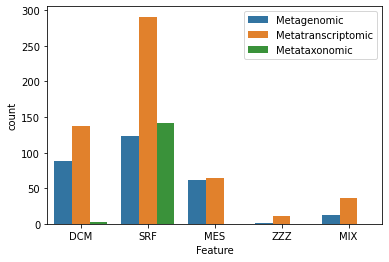

In [ ]:
sns.countplot(data=All_df_env, x="Feature", hue="Data_type")
plt.legend(loc='upper right')

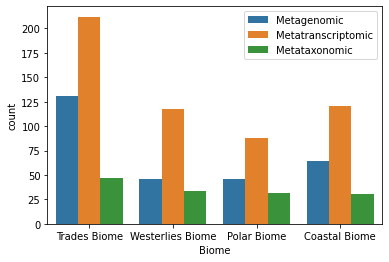

In [ ]:
sns.countplot(data=All_df_env, x="Biome", hue="Data_type")
plt.legend(loc='upper right')

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

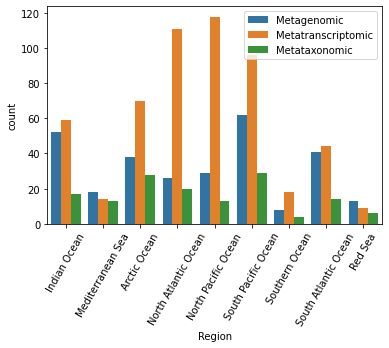

In [ ]:
sns.countplot(data=All_df_env, x="Region", hue="Data_type")
plt.legend(loc='upper right')
plt.xticks(rotation=60)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
 <a list of 30 Text major ticklabel objects>)

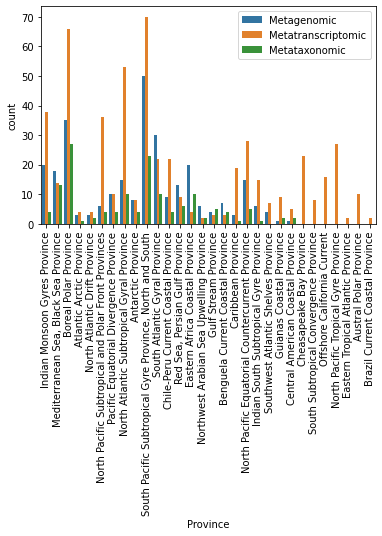

In [ ]:
# plt.subplots(figsize=(12, 9))
sns.countplot(data=All_df_env, x="Province", hue="Data_type")
plt.legend(loc='upper right')
plt.xticks(rotation=90)

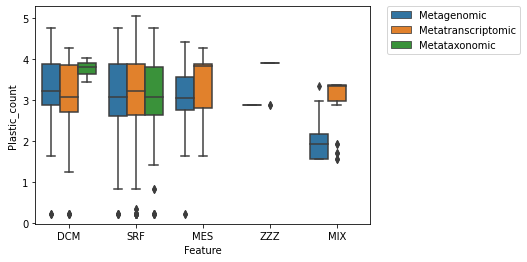

In [ ]:
sns.boxplot(x="Feature", y="Plastic_count", hue="Data_type", data=All_df_env)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

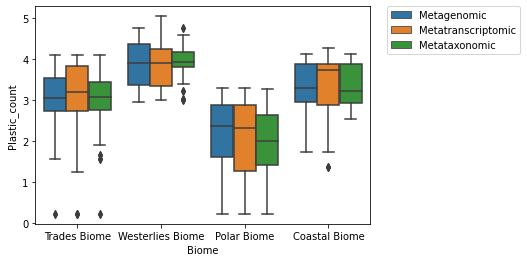

In [ ]:
sns.boxplot(x="Biome", y="Plastic_count", hue="Data_type", data=All_df_env)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

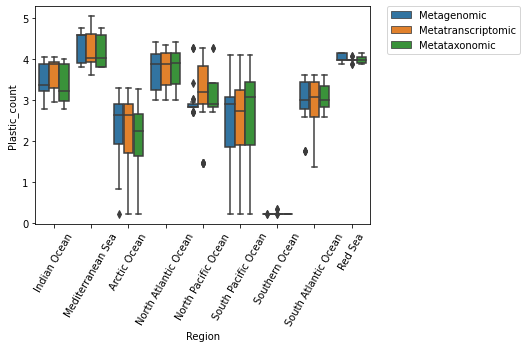

In [ ]:
sns.boxplot(x="Region", y="Plastic_count", hue="Data_type", data=All_df_env)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.xticks(rotation=60)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
 <a list of 30 Text major ticklabel objects>)

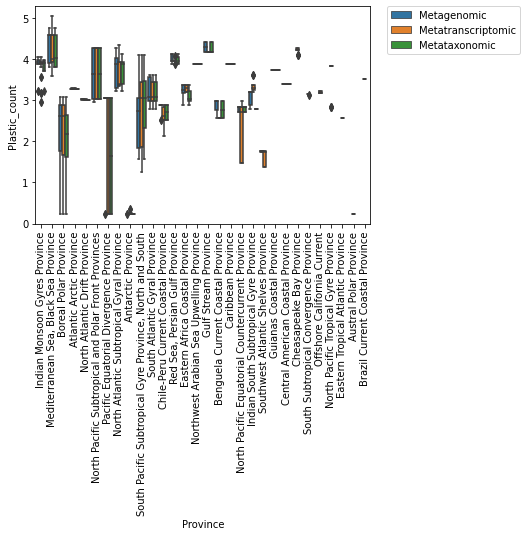

In [ ]:
sns.boxplot(x="Province", y="Plastic_count", hue="Data_type", data=All_df_env)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.xticks(rotation=90)

## Download PlasticDB database

In [ ]:
# Download sequences of proteins reported to degrade plastics from PlasticDB
!wget https://plasticdb.org/static/PlasticDB.fasta -O {path+"databases/PlasticDB/PlasticDB.fasta"}

--2022-07-26 01:56:05--  https://plasticdb.org/static/PlasticDB.fasta
Resolving plasticdb.org (plasticdb.org)... 130.216.217.99
Connecting to plasticdb.org (plasticdb.org)|130.216.217.99|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 75928 (74K) [application/octet-stream]
Saving to: ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases/PlasticDB/PlasticDB.fasta’

/content/drive/MyDr 100%[===================>]  74.15K   243KB/s    in 0.3s    

2022-07-26 01:56:06 (243 KB/s) - ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases/PlasticDB/PlasticDB.fasta’ saved [75928/75928]



In [ ]:
# Create diamond database from PlasticDB fasta file
!{path+"tools/"}diamond makedb --in {path+"databases/PlasticDB/PlasticDB.fasta"} --db {path+"databases/PlasticDB/PlasticDB"}

/bin/bash: /content/drive/MyDrive/Victor/PhD/Victor/Component_5/tools/diamond: Permission denied


In [ ]:
# Create a list with all plastics present in the PlsticDB fasta file
with open(path+"databases/PlasticDB/PlasticDB.fasta") as f:
  f = f.readlines()
  PlasticDB_plastics = []
  for line in f:
    if line.startswith(">"):
      for plastic in line.split("||")[3].rstrip().split("_"):
        if plastic not in PlasticDB_plastics:
          PlasticDB_plastics.append(plastic)

print(PlasticDB_plastics)

['PHB', 'PHA', 'PHO', 'PCL', 'PVA', 'PU', 'PPL', 'P3HP', 'P4HB', 'PEA', 'PES', 'O-PVA', 'PBS', 'PLA', 'P(3HB-co-3MP)', 'PEG', 'PHBV', 'PHPV', 'Nylon', 'PBSA', 'PET', 'PE', 'PBS-Blend', 'PBSA-Blend', 'P3HV', 'PBAT', 'PEF', 'PMCL', 'LDPE', 'PS', 'NR', 'PBSU', 'PESU']


## Download NCBI-nr database

In [ ]:
# Download the latest NCBI-nr database
!wget ftp://ftp.ncbi.nlm.nih.gov/blast/db/FASTA/nr.gz -O {path+"databases/nr/nr.gz"}

In [ ]:
# Create diamond database from nr fasta file
!{path+"tools/"}diamond makedb --in {path+"databases/nr/nr.gz"} --db {path+"databases/nr/nr"}

## Download MEGAN mapping file

In [ ]:
# Download MEGAN mapping file
!wget https://software-ab.informatik.uni-tuebingen.de/download/megan6/megan-map-Feb2022.db.zip -O {path+"databases/megan_mapping/megan-map-Feb2022.db.zip"}
! unzip {path+"databases/megan_mapping/megan-map-Feb2022.db.zip"}

--2022-06-02 02:54:27--  https://software-ab.informatik.uni-tuebingen.de/download/megan6/megan-map-Feb2022.db.zip
Resolving software-ab.informatik.uni-tuebingen.de (software-ab.informatik.uni-tuebingen.de)... 134.2.13.44
Connecting to software-ab.informatik.uni-tuebingen.de (software-ab.informatik.uni-tuebingen.de)|134.2.13.44|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2003248651 (1.9G) [application/zip]
Saving to: ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases/megan_mapping/megan-map-Feb2022.db.zip’

/content/drive/MyDr 100%[===================>]   1.87G  25.2MB/s    in 2m 41s  

2022-06-02 02:57:08 (11.9 MB/s) - ‘/content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases/megan_mapping/megan-map-Feb2022.db.zip’ saved [2003248651/2003248651]

Archive:  /content/drive/MyDrive/Victor/PhD/Victor/Component_5/databases/megan_mapping/megan-map-Feb2022.db.zip
  inflating: megan-map-Feb2022.db    


# Metatranscriptomic data analysis

## Diamond alignment

In [ ]:
# Use diamond to align sequences to PlasticDB database
base_count_mean = Metatranscriptomic_ENA.base_count.mean()
base_count_max = Metatranscriptomic_ENA.base_count.max()
for index, row in Metatranscriptomic_ENA.iloc[100:].iterrows():
    url1, url2 = row["fastq_ftp"].split(";")
    r1 = url1.split("/")[-1]
    r2 = url2.split("/")[-1]
    sample = r1.split("/")[-1].split("_")[0]
    db_path = path2+"databases/PlasticDB/PlasticDB"
    base_count = row["base_count"]
    #Sending Diamond jobs
    if base_count > base_count_max*0.8:
        job_time = "00:25:00"
    elif base_count > base_count_mean:
        job_time = "00:20:00"
    else:
        job_time = "00:15:00"
    job_memory = "8GB"
    job_cpus = 8
    # Read 1
    job_name = sample[-5:]+"_1"
    job_command = path2+"tools/"+"diamond blastx -q "+path+"metatranscriptomic_data/"+r1+" -d "+db_path+" -o "+path2+"metatranscriptomic_data/"+r1+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
    run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
    time.sleep(1)
    # Read 2
    job_name = sample[-5:]+"_2"
    job_command = path2+"tools/"+"diamond blastx -q "+path+"metatranscriptomic_data/"+r2+" -d "+db_path+" -o "+path2+"metatranscriptomic_data/"+r2+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
    run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
    time.sleep(1)

In [ ]:
# Redo jobs that ran out of time
base_count_mean = Metatranscriptomic_ENA.base_count.mean()
base_count_max = Metatranscriptomic_ENA.base_count.max()
for index, row in Metatranscriptomic_ENA.iloc[50:].iterrows():
    url1, url2 = row["fastq_ftp"].split(";")
    r1 = url1.split("/")[-1]
    r2 = url2.split("/")[-1]
    sample = r1.split("/")[-1].split("_")[0]
    db_path = path2+"databases/PlasticDB/PlasticDB"
    base_count = row["base_count"]
    job_memory = "8GB"
    job_cpus = 8
    #Sending Diamond jobs
    # Read 1
    if os.path.getsize(path2+"metatranscriptomic_data/"+r1+".tsv") == 0:
        job_time = "00:45:00"
        job_name = sample[-5:]+"_1"
        job_command = path2+"tools/"+"diamond blastx -q "+path+"metatranscriptomic_data/"+r1+" -d "+db_path+" -o "+path2+"metatranscriptomic_data/"+r1+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
        run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
        time.sleep(1)
    # Read 2
    if os.path.getsize(path2+"metatranscriptomic_data/"+r2+".tsv") == 0:
        job_time = "00:45:00"
        job_name = sample[-5:]+"_2"
        job_command = path2+"tools/"+"diamond blastx -q "+path+"metatranscriptomic_data/"+r2+" -d "+db_path+" -o "+path2+"metatranscriptomic_data/"+r2+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
        run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
        time.sleep(1)

In [ ]:
# Parse diamond results
Metatranscriptomic_diamond_raw_counts = pd.DataFrame(data=None, columns=PlasticDB_plastics)
for index, row in Metatranscriptomic_ENA.iterrows():
  url1, url2 = row["fastq_ftp"].split(";")
  r1 = path+"metatranscriptomic_data/"+url1.split("/")[-1]+".tsv"
  r2 = path+"metatranscriptomic_data/"+url2.split("/")[-1]+".tsv"
  sample = r1.split("/")[-1].split("_")[0]
  df = parse_diamond(sample, r1, r2, 1e-10, 30, PlasticDB_plastics)
  Metatranscriptomic_diamond_raw_counts = pd.concat([Metatranscriptomic_diamond_raw_counts, df])


Metatranscriptomic_diamond_raw_counts

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
ERR1001626,396,725,0,194,2,76,1,3,3,3,...,12,0,0,154,181,0,0,108,166,4
ERR1001627,51,74,0,25,1,67,0,0,0,0,...,1,0,0,17,91,0,0,25,55,0
ERR1328122,85,119,0,62,2,90,0,0,0,0,...,2,0,0,16,106,0,0,14,0,5
ERR1328123,254,345,0,159,0,282,0,0,0,0,...,0,0,0,50,639,0,0,48,0,1
ERR1328124,87,104,0,47,0,88,0,0,0,0,...,0,0,0,10,196,0,0,10,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3586746,7,43,0,109,0,127,0,0,0,0,...,1,0,0,11,132,0,0,33,6,26
ERR3586747,47,97,0,56,6,55,0,0,0,0,...,14,0,0,46,128,4,0,16,113,0
ERR3586748,3,4,0,59,0,57,0,0,0,0,...,0,0,0,1,40,0,0,17,15,4
ERR3586749,10,18,1,39,0,41,0,0,0,0,...,0,0,0,2,68,0,0,5,28,3


In [ ]:
Metatranscriptomic_diamond_raw_counts = Metatranscriptomic_diamond_raw_counts.sort_index()
Metatranscriptomic_diamond_raw_counts.to_csv(path+"Metatranscriptomic_diamond_raw_counts.tsv", sep = "\t")

In [ ]:
columns = Metatranscriptomic_diamond_raw_counts.columns
Metatranscriptomic_diamond_norm_counts = pd.DataFrame(columns=columns)

# Normalize count table by number of bases sequenced in each sample
for index, row in Metatranscriptomic_diamond_raw_counts.iterrows():
  base_count = Metatranscriptomic_ENA.loc[Metatranscriptomic_ENA['run_accession'] == index]["base_count"].iloc[0]
  Metatranscriptomic_diamond_norm_counts = Metatranscriptomic_diamond_norm_counts.append(row.div(base_count/1000000000))

Metatranscriptomic_diamond_norm_counts

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
ERR1001626,73.325913,134.245674,0.0,35.922291,0.370333,14.072650,0.185166,0.555499,0.555499,0.555499,...,2.221997,0.0,0.0,28.515633,33.515127,0.000000,0.0,19.997976,30.737630,0.740666
ERR1001627,12.278030,17.815181,0.0,6.018642,0.240746,16.129961,0.000000,0.000000,0.000000,0.000000,...,0.240746,0.0,0.0,4.092677,21.907858,0.000000,0.0,6.018642,13.241013,0.000000
ERR1328122,14.930205,20.902287,0.0,10.890267,0.351299,15.808452,0.000000,0.000000,0.000000,0.000000,...,0.351299,0.0,0.0,2.810391,18.618844,0.000000,0.0,2.459093,0.000000,0.878247
ERR1328123,8.448007,11.474655,0.0,5.288319,0.000000,9.379283,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,1.662994,21.253057,0.000000,0.0,1.596474,0.000000,0.033260
ERR1328124,10.116983,12.093865,0.0,5.465497,0.000000,10.233270,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,1.162872,22.792284,0.000000,0.0,1.162872,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3587200,13.641812,15.554215,0.0,5.099743,0.212489,9.732009,0.000000,0.084996,0.084996,0.084996,...,3.612318,0.0,0.0,1.699914,17.934095,0.424979,0.0,3.739811,0.042498,0.084996
ERR3587201,13.802977,15.413324,0.0,1.610347,0.460099,12.422679,0.000000,0.460099,0.460099,0.460099,...,0.690149,0.0,0.0,1.380298,23.695110,0.000000,0.0,2.530546,0.460099,1.380298
ERR3587202,6.253687,7.742660,0.0,3.573535,0.000000,11.911784,0.000000,0.000000,0.000000,0.000000,...,2.382357,0.0,0.0,1.488973,8.933838,0.000000,0.0,1.488973,0.000000,1.191178
ERR3587203,6.631980,8.842639,0.0,5.895093,0.000000,12.035815,0.000000,0.000000,0.000000,0.000000,...,0.982515,0.0,0.0,1.228144,13.263959,0.245629,0.0,3.193175,0.000000,1.719402


In [ ]:
Metatranscriptomic_diamond_norm_counts = Metatranscriptomic_diamond_norm_counts.sort_index()
Metatranscriptomic_diamond_norm_counts.to_csv(path+"Metatranscriptomic_diamond_norm_counts.tsv", sep = "\t")

## Statistical analysis

### Data desciption

In [ ]:
Metatranscriptomic_diamond_norm_counts = pd.read_csv(path+"Metatranscriptomic_diamond_norm_counts.tsv", sep = "\t", index_col=0)
Metatranscriptomic_diamond_norm_counts

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
ERR1001626,73.325913,134.245674,0.0,35.922291,0.370333,14.072650,0.185166,0.555499,0.555499,0.555499,...,2.221997,0.0,0.0,28.515633,33.515127,0.000000,0.0,19.997976,30.737630,0.740666
ERR1001627,12.278030,17.815181,0.0,6.018642,0.240746,16.129961,0.000000,0.000000,0.000000,0.000000,...,0.240746,0.0,0.0,4.092677,21.907858,0.000000,0.0,6.018642,13.241013,0.000000
ERR1328122,14.930205,20.902287,0.0,10.890267,0.351299,15.808452,0.000000,0.000000,0.000000,0.000000,...,0.351299,0.0,0.0,2.810391,18.618844,0.000000,0.0,2.459093,0.000000,0.878247
ERR1328123,8.448007,11.474655,0.0,5.288319,0.000000,9.379283,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,1.662994,21.253057,0.000000,0.0,1.596474,0.000000,0.033260
ERR1328124,10.116983,12.093865,0.0,5.465497,0.000000,10.233270,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,1.162872,22.792284,0.000000,0.0,1.162872,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3587200,13.641812,15.554215,0.0,5.099743,0.212489,9.732009,0.000000,0.084996,0.084996,0.084996,...,3.612318,0.0,0.0,1.699914,17.934095,0.424979,0.0,3.739811,0.042498,0.084996
ERR3587201,13.802977,15.413324,0.0,1.610347,0.460099,12.422679,0.000000,0.460099,0.460099,0.460099,...,0.690149,0.0,0.0,1.380298,23.695110,0.000000,0.0,2.530546,0.460099,1.380298
ERR3587202,6.253687,7.742660,0.0,3.573535,0.000000,11.911784,0.000000,0.000000,0.000000,0.000000,...,2.382357,0.0,0.0,1.488973,8.933838,0.000000,0.0,1.488973,0.000000,1.191178
ERR3587203,6.631980,8.842639,0.0,5.895093,0.000000,12.035815,0.000000,0.000000,0.000000,0.000000,...,0.982515,0.0,0.0,1.228144,13.263959,0.245629,0.0,3.193175,0.000000,1.719402


In [ ]:
Metatranscriptomic_env = pd.read_csv(path+"Metatranscriptomic_env.tsv", sep = "\t", index_col=0)
Metatranscriptomic_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,SSM,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count
ERR1001626,High Volume Peristaltic Pump,2010,-20.9354,-35.1803,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,1.200000e-07,0.479170,2.691546,0.084131,0.027592,0.000000,120.0,-21.0,-35.2,3.449604
ERR1001627,High Volume Peristaltic Pump,2010,-30.1367,-43.2899,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,1.578700e-05,8.645021,-6.421140,0.053558,0.148190,5.777778,68.0,-30.2,-43.2,2.993198
ERR1328122,High Volume Peristaltic Pump,2012,36.1715,-29.0230,SRF,3.0,0.22-3,Westerlies Biome,North Atlantic Ocean,North Atlantic Subtropical Gyral Province,...,1.058100e-05,-4.997032,3.058714,-0.157861,0.025897,37.583333,76.0,36.2,-29.0,3.896750
ERR1328123,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
ERR1328124,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,9.598900e-05,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3587200,High Volume Peristaltic Pump,2011,-8.9111,-142.5571,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,8.210000e-07,1.059620,-2.544526,-0.004254,0.014455,0.000000,120.0,-9.0,-142.6,1.676520
ERR3587201,High Volume Peristaltic Pump,2011,-8.9971,-139.1963,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,4.056000e-06,-13.524453,5.403076,0.007751,0.028977,15.833333,120.0,-9.0,-139.2,1.903081
ERR3587202,High Volume Peristaltic Pump,2011,-8.9068,-140.2830,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,1.077000e-06,-4.286042,2.890793,-0.011503,0.053774,1.083333,120.0,-9.0,-140.2,1.567905
ERR3587203,High Volume Peristaltic Pump,2011,-9.1504,-140.5216,SRF,3.0,0.22-3,Trades Biome,South Pacific Ocean,"South Pacific Subtropical Gyre Province, North...",...,2.460000e-06,-2.752385,-2.994587,0.000096,0.043603,2.777778,37.0,-9.2,-140.6,1.841432


In [ ]:
Metatranscriptomic_diamond_norm_counts.describe()

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
count,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,...,539.000000,539.0,539.0,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000
mean,43.288325,56.436573,0.073061,13.384566,1.423927,15.266210,0.272136,0.467883,0.467883,0.467883,...,2.017175,0.0,0.0,10.329426,29.597465,0.529209,0.026310,7.680738,8.371952,1.096010
std,83.749485,95.831086,0.366094,16.113008,2.613813,12.683208,0.774213,1.132364,1.132364,1.132364,...,5.578044,0.0,0.0,13.939124,19.682008,1.473698,0.246150,9.384121,27.753311,1.642775
min,0.383213,0.900475,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.000000,4.857300,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.391628,13.838711,0.000000,4.225765,0.106010,8.343458,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,3.096421,18.613961,0.000000,0.000000,2.198567,0.239654,0.143599
50%,16.514780,24.873068,0.000000,7.456463,0.500905,11.632570,0.000000,0.073956,0.073956,0.073956,...,0.440022,0.0,0.0,5.539578,22.933201,0.000000,0.000000,4.141804,1.048121,0.536701
75%,37.065253,49.599651,0.000000,17.752612,1.282511,16.103835,0.180222,0.341935,0.341935,0.341935,...,1.522036,0.0,0.0,10.913971,33.434404,0.385283,0.000000,9.058037,7.261563,1.300419
max,556.934623,653.597989,7.048843,136.944965,16.596406,94.457211,6.815479,8.543320,8.543320,8.543320,...,55.902942,0.0,0.0,90.475203,134.678892,16.853413,3.350395,60.644656,416.528412,14.456678


In [ ]:
df = Metatranscriptomic_diamond_norm_counts.describe().T.sort_values("mean", ascending=False)
df["Plastic"] = df.index
df

,count,mean,std,min,25%,50%,75%,max,Plastic
PEG,539.0,287.924707,124.598904,63.835987,199.636110,258.340233,350.329591,739.876248,PEG
PHA,539.0,56.436573,95.831086,0.900475,13.838711,24.873068,49.599651,653.597989,PHA
PHB,539.0,43.288325,83.749485,0.383213,7.391628,16.514780,37.065253,556.934623,PHB
PLA,539.0,33.221996,32.092073,2.688825,17.158105,23.877936,38.515343,285.118942,PLA
PBAT,539.0,29.597465,19.682008,4.857300,18.613961,22.933201,33.434404,134.678892,PBAT
PET,539.0,25.033538,18.511232,3.376416,14.348073,20.420592,28.097352,164.615768,PET
PU,539.0,15.266210,12.683208,0.000000,8.343458,11.632570,16.103835,94.457211,PU
PBSA,539.0,14.531780,18.731788,0.660701,4.700923,7.711439,15.971859,157.675990,PBSA
PCL,539.0,13.384566,16.113008,0.000000,4.225765,7.456463,17.752612,136.944965,PCL
PHBV,539.0,12.997429,15.232672,0.000000,4.812314,8.428903,13.433744,96.449981,PHBV


Text(0.5, 0, 'Mean hit per billion nucleotides')

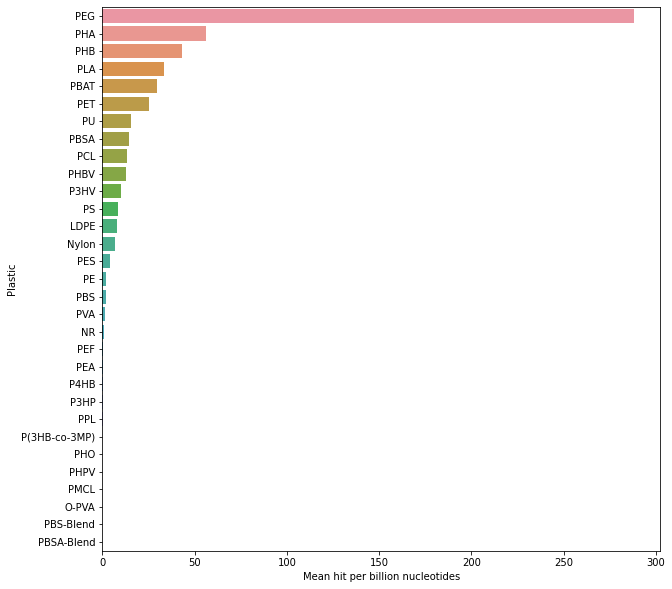

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
ax = sns.barplot(y="Plastic", x="mean", data=df)
plt.xlabel("Mean hit per billion nucleotides")

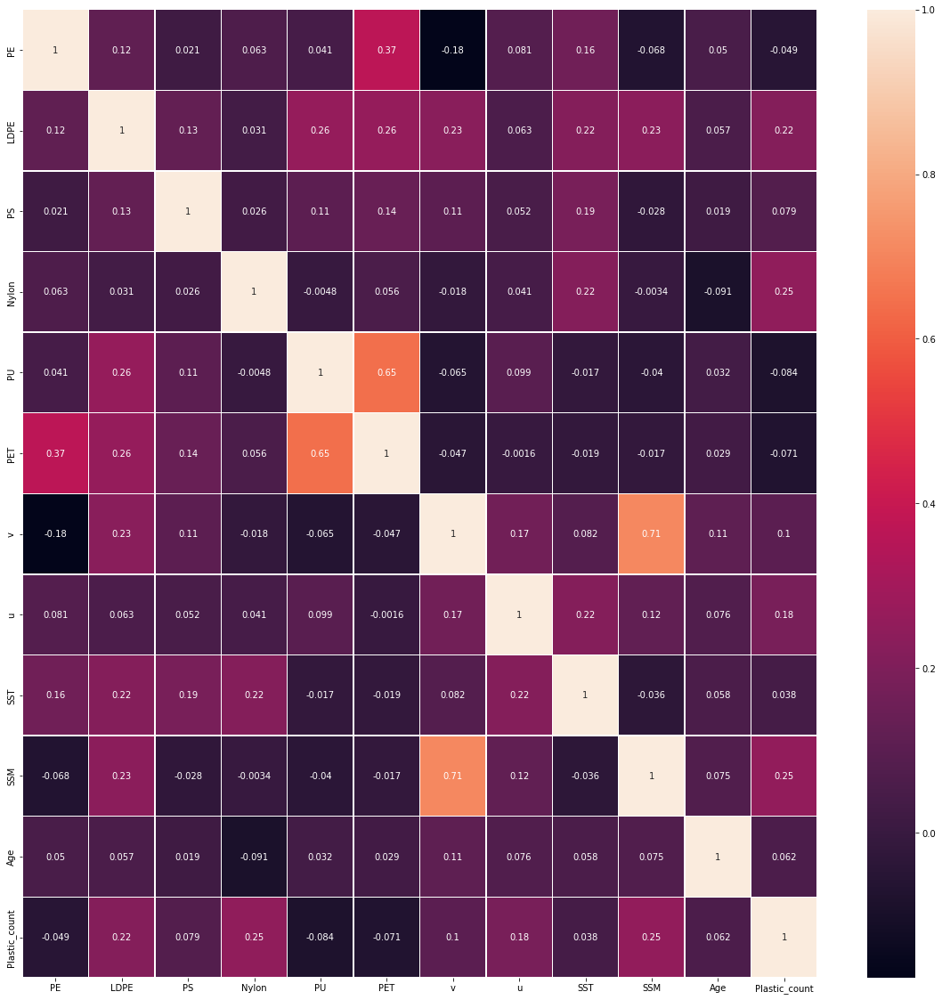

In [ ]:
df = Metatranscriptomic_diamond_norm_counts.copy()
df_env = Metatranscriptomic_env.copy()
# df_env = df_env[df_env.Feature == "SRF"]
df_env = df_env[df_env.Biome != "Polar Biome"]
df = df.loc[df_env.index]
df = df[["PE", "LDPE", "PS", "Nylon", "PU", "PET"]]
df = df.drop(["ERR3587157", "ERR3587132"])
df_env = df_env.drop(["ERR3587157", "ERR3587132"])
df["v"] = df_env["v"]
df["u"] = df_env["u"]
df["SST"] = df_env["SST"]
df["SSM"] = df_env["SSM"]
df["Age"] = df_env["Age"]
df["Plastic_count"] = df_env["Plastic_count"]

corrmat = df.corr(method="pearson")
fig, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corrmat, vmax=1, annot=True, linewidths=.5)
plt.show()

### Kmeans

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
km = KMeans(n_clusters=5)
y_predicted = km.fit_predict(Metatranscriptomic_diamond_norm_counts)
y_predicted

array([1, 2, 2, 2, 2, 2, 2, 2, 4, 4, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 4,
       2, 2, 0, 2, 0, 2, 2, 4, 2, 2, 4, 4, 4, 2, 2, 4, 2, 2, 4, 2, 4, 2,
       2, 0, 2, 0, 2, 2, 0, 2, 2, 4, 4, 4, 2, 2, 4, 2, 2, 2, 2, 2, 2, 4,
       2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 2, 0, 2, 2, 4, 0, 4, 2, 4, 0, 2, 2,
       2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 0, 0, 0, 2, 0, 0, 0, 0, 4, 2, 2, 2, 0, 0, 0, 0, 0,
       0, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 2, 2, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 4, 2, 0, 2, 2, 2, 2, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0,
       0, 0, 2, 0, 4, 0, 4, 1, 0, 2, 0, 1, 2, 0, 1, 0, 0, 2, 2, 2, 2, 2,
       2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 1, 0, 2, 0, 0, 1, 2, 4, 2, 4,
       0, 2, 2, 2, 2, 4, 0, 0, 0, 2, 0, 0, 0, 0, 0,

### PCA from sklearn

In [ ]:
import random as rd
from sklearn.decomposition import PCA
from sklearn import preprocessing
from matplotlib import pyplot as plt

Text(0.5, 1.0, 'Scree Plot')

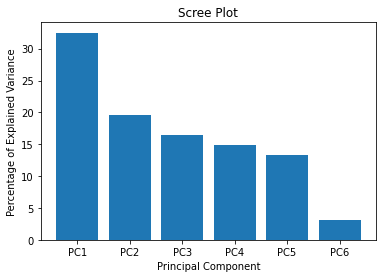

In [ ]:
df = Metatranscriptomic_diamond_norm_counts.copy()
df_env = Metatranscriptomic_env.copy()
# df_env = df_env[df_env.Feature == "SRF"]
# df_env = df_env[df_env.Biome != "Polar Biome"]
df = df.loc[df_env.index]
df = df[["PE", "LDPE", "PS", "Nylon", "PU", "PET"]]
df = df.drop(["ERR3587157", "ERR3587132"])
df_env = df_env.drop(["ERR3587157", "ERR3587132"])

scaled_data = preprocessing.scale(df)
# scaled_data = df.copy()
pca = PCA()
pca.fit(scaled_data)
pca_data = pca.transform(scaled_data)

per_var = np.round(pca.explained_variance_ratio_*100, decimals=1)
labels = ["PC" + str(i) for i in range(1, len(per_var)+1)]

plt.bar(x=range(1, len(per_var)+1), height = per_var, tick_label=labels)
plt.ylabel("Percentage of Explained Variance")
plt.xlabel("Principal Component")
plt.title("Scree Plot")

In [ ]:
pca_df = pd.DataFrame(pca_data, index=df.index.to_list(), columns=labels)
pca_df

,PC1,PC2,PC3,PC4,PC5,PC6
ERR1001626,0.671777,1.293282,1.621467,0.213575,0.324037,-0.001058
ERR1001627,-0.216762,-0.034965,0.536830,-0.104669,-0.250474,-0.196273
ERR1328122,-0.495136,-0.640061,-0.289132,-0.118705,-0.128096,-0.140462
ERR1328123,-1.069364,-0.571998,-0.204730,0.057724,-0.048729,-0.019515
ERR1328124,-1.049697,-0.554627,-0.232212,-0.027183,-0.103493,-0.069558
...,...,...,...,...,...,...
ERR3587200,-0.769362,-0.235134,-0.486489,0.498411,0.027120,-0.114277
ERR3587201,-0.493475,-0.577145,-0.309914,0.037787,-0.150656,0.178458
ERR3587202,-0.860665,-0.660007,-0.353992,0.570181,-0.110629,-0.251656
ERR3587203,-0.749113,-0.693777,-0.218053,0.350017,0.040543,-0.101191


In [ ]:
from sklearn.preprocessing import LabelEncoder
column = LabelEncoder()
cmap = column.fit_transform(df_env["Region"])
mapping = dict(zip(column.transform(column.classes_), column.classes_))
mapping

{0: 'Arctic Ocean',
 1: 'Indian Ocean',
 2: 'Mediterranean Sea',
 3: 'North Atlantic Ocean',
 4: 'North Pacific Ocean',
 5: 'Red Sea',
 6: 'South Atlantic Ocean',
 7: 'South Pacific Ocean',
 8: 'Southern Ocean'}

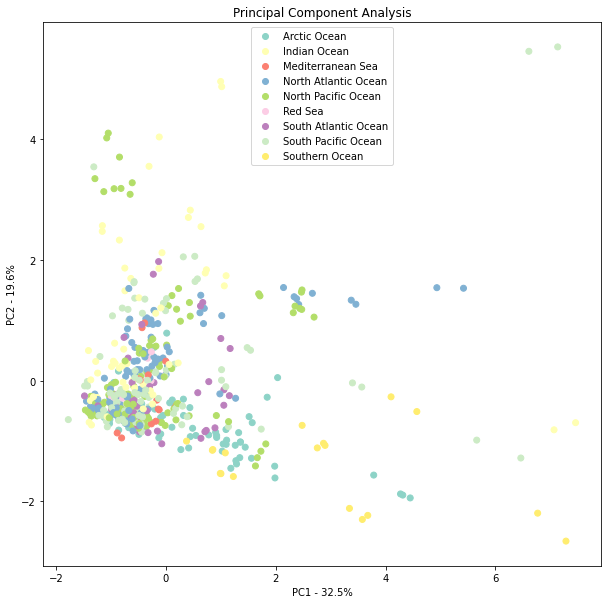

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
scatter = plt.scatter(pca_df.PC1, pca_df.PC2, c=cmap, label=labels, cmap="Set3")
plt.title("Principal Component Analysis")
plt.xlabel("PC1 - {0}%".format(per_var[0]))
plt.ylabel("PC2 - {0}%".format(per_var[1]))
handles, labels = scatter.legend_elements()
labels = [int(''.join(i for i in x if i.isdigit())) for x in labels]
labels = [mapping[x] for x in labels]
plt.legend(handles, labels)

# for sample in pca_df.index:
#   plt.annotate(sample, (pca_df.PC1.loc[sample], pca_df.PC2.loc[sample]))

In [ ]:
loading_scores = pd.Series(pca.components_[0], index=df.columns.to_list())
sorted_loading_scores = loading_scores.abs().sort_values(ascending=False)
sorted_loading_scores

PET      0.653913
PU       0.612922
LDPE     0.367743
PE       0.197210
PS       0.144642
Nylon    0.040950
dtype: float64

### PCA using PCA library

In [ ]:
!pip install pca

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 24.8 MB 2.5 MB/s 
  Created wheel for sklearn: filename=sklearn-0.0-py2.py3-none-any.whl size=1316 sha256=d786db0eff7904e8fa8f558fb2881c61e044d239a9275d9381980a6f91b74e2a
  Stored in directory: /root/.cache/pip/wheels/46/ef/c3/157e41f5ee1372d1be90b09f74f82b10e391eaacca8f22d33e
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9680 sha256=ca5a724a0bfa24f000867ec6402b9b9f1ae07c70dd0a38e8b3eafde156dc69a6
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built sklearn wget


In [ ]:
# https://erdogant.github.io/pca/pages/html/Examples.html#
from pca import pca

# Initialize to reduce the data up to the nubmer of componentes that explains 95% of the variance.
model = pca(n_components=0.95)

# Reduce the data towards 3 PCs
# model = pca(n_components=3)
df = Metatranscriptomic_diamond_norm_counts.copy()
df_env = Metatranscriptomic_env.copy()
df_env = df_env[df_env.Feature == "SRF"]
df_env = df_env[df_env.Biome != "Polar Biome"]
df = df.loc[df_env.index]
df = df[["PE", "LDPE", "PS", "Nylon", "PU", "PET"]]
df = df.drop(["ERR3587157", "ERR3587132"])
df_env = df_env.drop(["ERR3587157", "ERR3587132"])


# Fit transform
results = model.fit_transform(df)

[pca] >Processing dataframe..
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [6] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [5] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [6] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[5]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]


[0.35822161 0.62573763 0.85544747 0.94820028 0.99365021 1.        ]
[0.35822161 0.26751602 0.22970984 0.09275281 0.04544992 0.00634979]


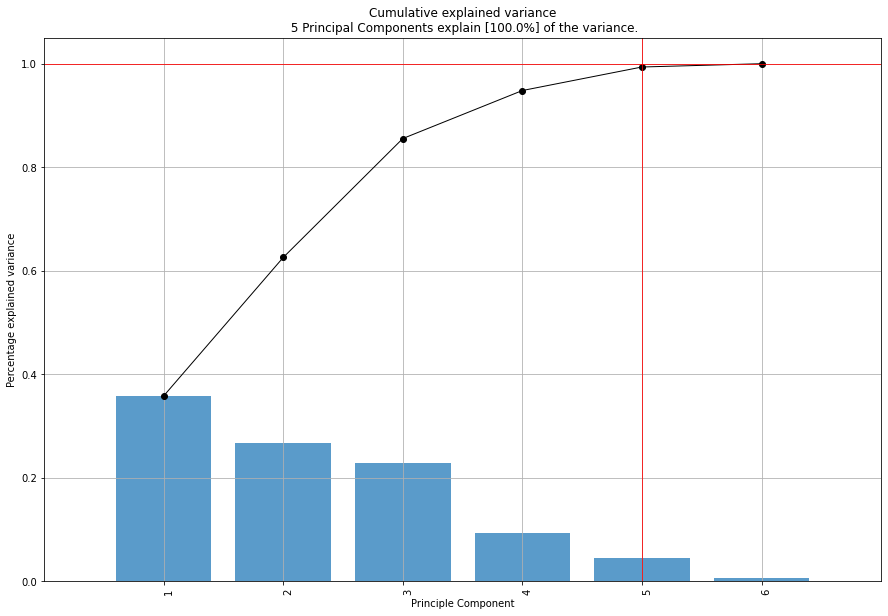

<Figure size 432x288 with 0 Axes>

In [ ]:
# Cumulative explained variance
print(model.results['explained_var'])
# [0.92461872 0.97768521 0.99478782]

# Explained variance per PC
print(model.results['variance_ratio'])
[0.92461872, 0.05306648, 0.01710261]

# Make plot
fig, ax = model.plot()

[pca] >Plot PC1 vs PC2 with loadings.


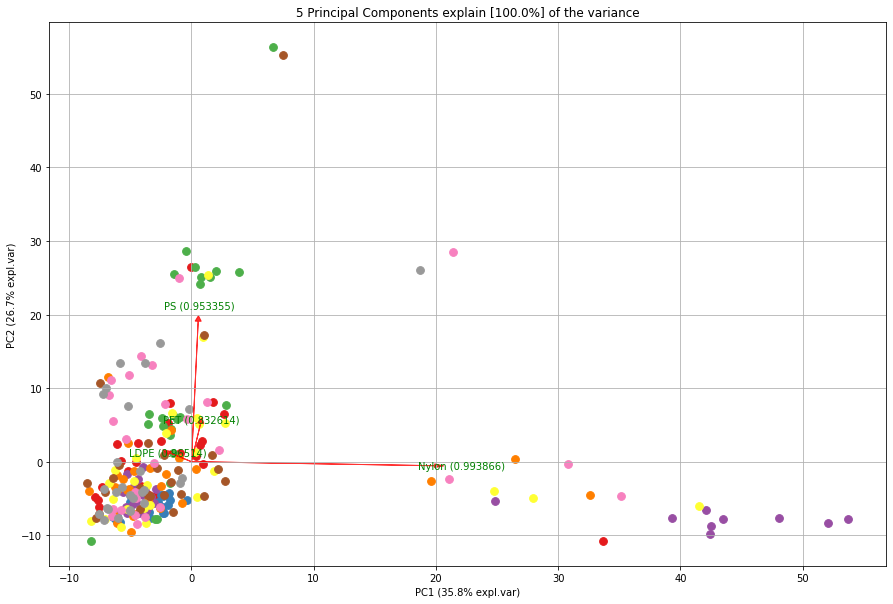

In [ ]:
# 2D plot
fig, ax = model.biplot(n_feat=4, PC=[0,1], label=False, legend=False)

[pca] >Plot PC1 vs PC2 vs PC3 with loadings.


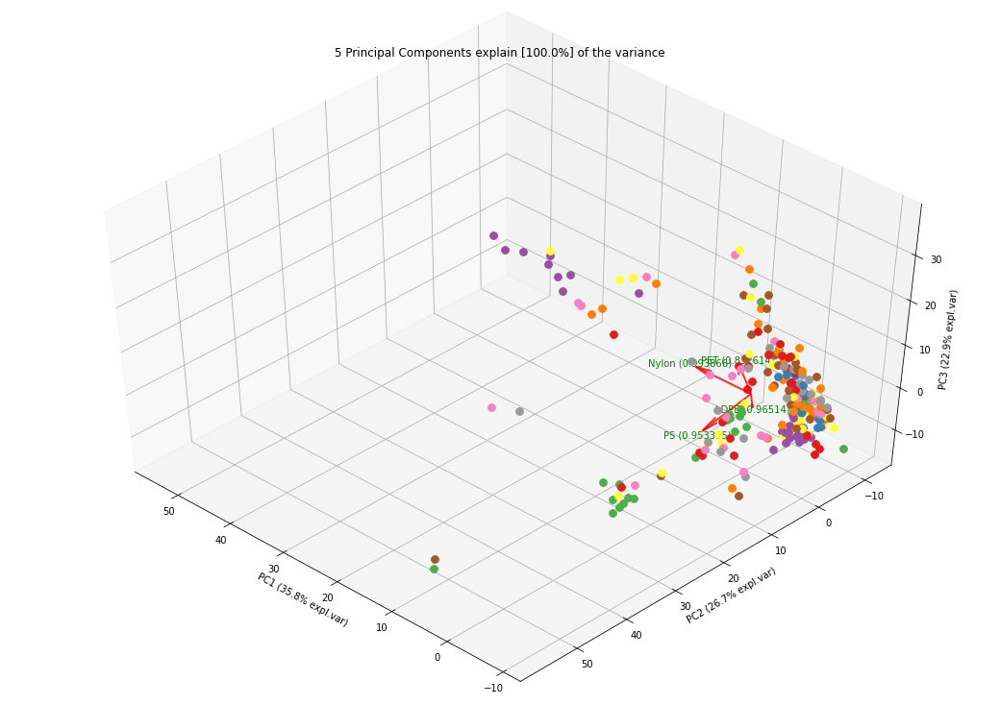

In [ ]:
# 3d Plot
fig, ax = model.biplot3d(n_feat=4, PC=[0,1,2], label=False, legend=False)

### R

In [ ]:
%load_ext rpy2.ipython

In [ ]:
df = Metatranscriptomic_diamond_norm_counts.copy()
df_env = Metatranscriptomic_env.copy()
# df_env = df_env[df_env.Feature == "SRF"]
# df_env = df_env[df_env.Biome != "Polar Biome"]
df = df.loc[df_env.index]
df = df[["PE", "LDPE", "PS", "Nylon", "PU", "PET"]]
df = df.drop(["ERR3587157", "ERR3587132"])
df_env = df_env.drop(["ERR3587157", "ERR3587132"])
df_env.to_csv(path+"df_env.tsv", sep = "\t")
df.to_csv(path+"df.tsv", sep = "\t")


In [ ]:
# Install packages
%%R
install.packages("vegan")
install.packages("MASS")
install.packages("ggplot2")


R[write to console]: Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

R[write to console]: also installing the dependency ‘permute’


R[write to console]: trying URL 'https://cran.rstudio.com/src/contrib/permute_0.9-7.tar.gz'

R[write to console]: Content type 'application/x-gzip'
R[write to console]:  length 114805 bytes (112 KB)

R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to 

In [ ]:
%%R

library(vegan)
library(MASS)
library(ggplot2)
data(varespec)



R[write to console]: Loading required package: permute

R[write to console]: Loading required package: lattice

R[write to console]: This is vegan 2.6-2

R[write to console]: Need help getting started? Try the R Graphics Cookbook:
https://r-graphics.org



In [ ]:
%%R
setwd("/content/drive/MyDrive/Victor/PhD/Victor/Component_5/")
getwd()

[1] "/content/drive/MyDrive/Victor/PhD/Victor/Component_5"


In [ ]:
%%R
df <- read.table("df.tsv", sep="\t", header = TRUE, row.names = 1)
df_env <- read.table("df_env.tsv", sep="\t", header=TRUE, row.names = 1)
# keeps <- c("SSD", "NH4")
# DF[keeps]
nums <- unlist(lapply(df_env, is.numeric), use.names = FALSE)
df_env_num <- df_env[ , nums]
df_env_num["Feature"] <- df_env["Feature"]
head(df_env_num)


           Year Latitude Longitude Depth.top SSD      PAR      SST          Fe
ERR1001626 2010 -20.9354  -35.1803         3 755 50.91439 23.79766 0.000776878
ERR1001627 2010 -30.1367  -43.2899         3 802 58.56081 20.82677 0.000862562
ERR1328122 2012  36.1715  -29.0230         3 704 39.29236 17.12831 0.001299510
ERR1328123 2010  18.5839   66.4727        23 724 50.03510       NA 0.001387720
ERR1328124 2010  18.5839   66.4727        23 724 50.03510       NA 0.001387720
ERR1328125 2012  36.1715  -29.0230         3 704 39.29236 17.12831 0.001299510
                  NH4         NO2         NO3     SSChla     Chl     Ssphi
ERR1001626 0.01195919 0.013930039 0.013453111 0.03903924 15.6180 1.0898206
ERR1001627 0.01771856 0.012364627 0.001974124 0.06848840 20.9027 1.7372093
ERR1328122 0.02104487 0.036169071 0.306125077 0.12386455 16.2202 1.0030402
ERR1328123 0.02551020 0.004728645 0.003323513 0.30926001 29.1818 0.8137735
ERR1328124 0.02551020 0.004728645 0.003323513 0.30926001 29.1818 0.81377

In [ ]:
%%R

vare.dis <- vegdist(df)
vare.mds <- metaMDS(df, trace = FALSE)
vare.mds


Call:
metaMDS(comm = df, trace = FALSE) 

global Multidimensional Scaling using monoMDS

Data:     wisconsin(sqrt(df)) 
Distance: bray 

Dimensions: 2 
Stress:     0.1877347 
Stress type 1, weak ties
No convergent solutions - best solution after 20 tries
Scaling: centring, PC rotation, halfchange scaling 
Species: expanded scores based on ‘wisconsin(sqrt(df))’ 



In [ ]:
%%R

ef <- envfit(vare.mds, df_env_num, permu = 999, na.rm=TRUE)
ef


***VECTORS

                 NMDS1    NMDS2     r2 Pr(>r)    
Year          -0.75632 -0.65420 0.0117  0.173    
Latitude      -0.74976  0.66171 0.0276  0.017 *  
Longitude      0.58417 -0.81163 0.0354  0.005 ** 
Depth.top     -0.94714 -0.32083 0.1749  0.001 ***
SSD            0.90622 -0.42281 0.1324  0.001 ***
PAR            0.67339  0.73929 0.0496  0.001 ***
SST           -0.85596  0.51704 0.1989  0.001 ***
Fe            -0.88402  0.46745 0.0228  0.037 *  
NH4            0.99782  0.06598 0.0694  0.001 ***
NO2            0.57508 -0.81810 0.0240  0.024 *  
NO3            0.61601 -0.78774 0.1026  0.001 ***
SSChla         0.73732 -0.67554 0.0346  0.005 ** 
Chl            0.88663 -0.46249 0.0434  0.003 ** 
Ssphi          0.93138 -0.36405 0.0052  0.459    
POC            0.70003 -0.71411 0.0568  0.001 ***
PIC            0.95964 -0.28122 0.0920  0.001 ***
Bathy.depth    0.40183 -0.91571 0.0111  0.201    
SST.1         -0.07999 -0.99680 0.0607  0.001 ***
SSM           -0.95307 -0.30276 0.022

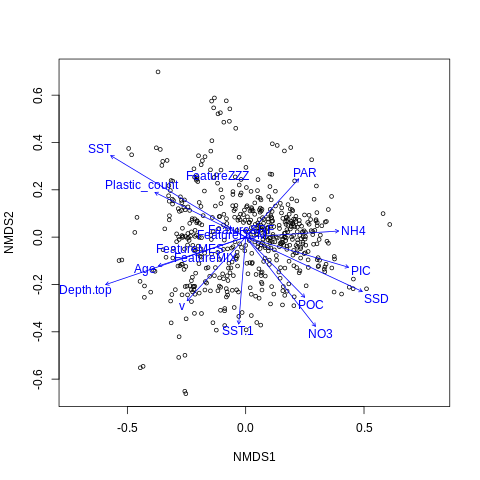

In [ ]:
%%R


plot(vare.mds, display = "sites")
plot(ef, p.max = 0.001)
# text(vare.mds, display = "species")


In [ ]:
%%R


#extract NMDS scores (x and y coordinates) for sites from newer versions of vegan package
data.scores = as.data.frame(scores(vare.mds)$sites)

#add 'season' column as before
data.scores$season = df_env$Feature

en_coord_cont = as.data.frame(scores(ef, "vectors")) * ordiArrowMul(ef)
en_coord_cat = as.data.frame(scores(ef, "factors")) * ordiArrowMul(ef)

gg = ggplot(data = data.scores, aes(x = NMDS1, y = NMDS2)) +
     geom_point(data = data.scores, aes(colour = Feature), size = 3, alpha = 0.5) +
     scale_colour_manual(values = c("orange", "steelblue"))  +
     geom_segment(aes(x = 0, y = 0, xend = NMDS1, yend = NMDS2),
       data = en_coord_cont, size =1, alpha = 0.5, colour = "grey30") +
     geom_point(data = en_coord_cat, aes(x = NMDS1, y = NMDS2),
       shape = "diamond", size = 4, alpha = 0.6, colour = "navy") +
     geom_text(data = en_coord_cat, aes(x = NMDS1, y = NMDS2+0.04),
       label = row.names(en_coord_cat), colour = "navy", fontface = "bold") +
     geom_text(data = en_coord_cont, aes(x = NMDS1, y = NMDS2), colour = "grey30",
       fontface = "bold", label = row.names(en_coord_cont)) +
     theme(axis.title = element_text(size = 10, face = "bold", colour = "grey30"),
       panel.background = element_blank(), panel.border = element_rect(fill = NA, colour = "grey30"),
       axis.ticks = element_blank(), axis.text = element_blank(), legend.key = element_blank(),
       legend.title = element_text(size = 10, face = "bold", colour = "grey30"),
       legend.text = element_text(size = 9, colour = "grey30")) +
     labs(colour = "Feature")

gg

R[write to console]: Error in FUN(X[[i]], ...) : object 'Feature' not found



RRuntimeError: ignored

In [ ]:
%%R

install.packages("devtools")
devtools::install_github("cran/mvpart")

R[write to console]: Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

R[write to console]: also installing the dependencies ‘Rcpp’, ‘httpuv’, ‘xtable’, ‘fontawesome’, ‘sourcetools’, ‘later’, ‘promises’, ‘textshaping’, ‘shiny’, ‘downlit’, ‘ragg’, ‘htmlwidgets’, ‘miniUI’, ‘pkgdown’, ‘profvis’, ‘roxygen2’, ‘urlchecker’


R[write to console]: trying URL 'https://cran.rstudio.com/src/contrib/Rcpp_1.0.9.tar.gz'

R[write to console]: Content type 'application/x-gzip'
R[write to console]:  length 2957812 bytes (2.8 MB)

R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to 

* checking for file ‘/tmp/Rtmp9SwYKR/remotesfe4eca5f33/cran-mvpart-acf0035/DESCRIPTION’ ... OK
* preparing ‘mvpart’:
* checking DESCRIPTION meta-information ... OK
* cleaning src
* checking for LF line-endings in source and make files and shell scripts
* checking for empty or unneeded directories
* building ‘mvpart_1.6-2.tar.gz’



R[write to console]: Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
%%R

df_env_t = t(df_env)
df_env_t

Streaming output truncated to the last 5000 lines.
RT              " 0.000000"                          
Age             "120"                                
Lat_plastic     "-39.6"                              
Lon_plastic     " -77.0"                             
Plastic_count   "2.1332164"                          
                ERR3587058                           
Device          "High Volume Peristaltic Pump"       
Year            "2011"                               
Latitude        "-34.1610"                           
Longitude       " -73.0995"                          
Feature         "SRF"                                
Depth.top       "  3"                                
Sample.material "0.22-3"                             
Biome           "Coastal Biome"                      
Region          "South Pacific Ocean"                
Province        "Chile-Peru Current Coastal Province"
Season          "summer"                             
Season.period   "middle"       

In [ ]:
%%R
rownames(df_env_t)

 [1] "Device"          "Year"            "Latitude"        "Longitude"      
 [5] "Feature"         "Depth.top"       "Sample.material" "Biome"          
 [9] "Region"          "Province"        "Season"          "Season.period"  
[13] "SSD"             "PAR"             "SST"             "Fe"             
[17] "NH4"             "NO2"             "NO3"             "SSChla"         
[21] "Chl"             "Ssphi"           "POC"             "PIC"            
[25] "Bathy.depth"     "SST.1"           "SSM"             "u"              
[29] "v"               "OW"              "MLE"             "RT"             
[33] "Age"             "Lat_plastic"     "Lon_plastic"     "Plastic_count"  


In [ ]:
%%R

abundance <- df
environmental_variables <- df_env_t

formula <- abundance ~ Device + Year + Latitude + Longitude + Feature + Depth.top + Sample.material + Biome+Region + Province + Season + Season.period + SSD + PAR + SST + Fe + NH4 + NO2 + NO3 + SSChla + Chl + Ssphi + POC + PIC +Bathy.depth + SST.1 + SSM + u + v + OW + MLE + RT + Age + Lat_plastic + Lon_plastic + Plastic_count

# Set a new seed for random numbers to ensure results are reproducible
set.seed(1)

# See `?mvpart()` for argument details
mvpart_run1 <- mvpart(
  form = formula,
  data = environmental_variables,
  all.leaves = TRUE,  # annotate all nodes
  rsq = TRUE,  # give "rsq" plot
  pca = TRUE,  # plot PCA of group means and add species and site information
  wgt.ave.pca = TRUE  # plot weighted averages acorss sites for species

RParsingError: ignored

In [ ]:
str(mvpart_run1)


In [ ]:
summary(mvpart_run1)


In [ ]:
table(mvpart_run1$where)


In [ ]:
plot_where <- function(run) {
  run <- get(run)
  # Data
  index <- 1:600
  grouped_quadrats <- index %>%
    index.to.gxgy(plotdim = c(600, 400)) %>%
    as_tibble() %>%
    mutate(
      index = index,
      group = as.factor(run$where)
    )

  # Plot
  ggplot(grouped_quadrats, aes(gx, gy)) +
    geom_raster(aes(fill = group)) +
    geom_text(aes(label = index)) +
    theme_minimal()
}
plot_where("mvpart_run1")

### Model

In [ ]:
keep = Metatranscriptomic_env[Metatranscriptomic_env.Feature == "SRF"].index
keep

Index(['ERR1001626', 'ERR1001627', 'ERR1328122', 'ERR1328125', 'ERR1328126',
       'ERR1328127', 'ERR1336911', 'ERR1336912', 'ERR3562601', 'ERR3586678',
       ...
       'ERR3587192', 'ERR3587195', 'ERR3587197', 'ERR3587198', 'ERR3587199',
       'ERR3587200', 'ERR3587201', 'ERR3587202', 'ERR3587203', 'ERR3587204'],
      dtype='object', length=291)

In [ ]:
X = Metatranscriptomic_diamond_norm_counts.copy()
X = X.loc[keep]
# X = X.drop(["PEG", "PHA", "PHB"], axis=1)
X

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
ERR1001626,73.325913,134.245674,0.0,35.922291,0.370333,14.072650,0.185166,0.555499,0.555499,0.555499,...,2.221997,0.0,0.0,28.515633,33.515127,0.000000,0.0,19.997976,30.737630,0.740666
ERR1001627,12.278030,17.815181,0.0,6.018642,0.240746,16.129961,0.000000,0.000000,0.000000,0.000000,...,0.240746,0.0,0.0,4.092677,21.907858,0.000000,0.0,6.018642,13.241013,0.000000
ERR1328122,14.930205,20.902287,0.0,10.890267,0.351299,15.808452,0.000000,0.000000,0.000000,0.000000,...,0.351299,0.0,0.0,2.810391,18.618844,0.000000,0.0,2.459093,0.000000,0.878247
ERR1328125,16.090889,21.063583,0.0,8.115813,0.281473,12.244087,0.046912,0.187649,0.187649,0.187649,...,0.375298,0.0,0.0,3.236943,20.922846,0.000000,0.0,2.157962,0.000000,0.938244
ERR1328126,6.034605,9.097625,0.0,3.657337,0.731467,10.514843,0.000000,0.045717,0.045717,0.045717,...,0.000000,0.0,0.0,1.874385,16.595165,0.000000,0.0,0.594317,2.011535,0.045717
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3587200,13.641812,15.554215,0.0,5.099743,0.212489,9.732009,0.000000,0.084996,0.084996,0.084996,...,3.612318,0.0,0.0,1.699914,17.934095,0.424979,0.0,3.739811,0.042498,0.084996
ERR3587201,13.802977,15.413324,0.0,1.610347,0.460099,12.422679,0.000000,0.460099,0.460099,0.460099,...,0.690149,0.0,0.0,1.380298,23.695110,0.000000,0.0,2.530546,0.460099,1.380298
ERR3587202,6.253687,7.742660,0.0,3.573535,0.000000,11.911784,0.000000,0.000000,0.000000,0.000000,...,2.382357,0.0,0.0,1.488973,8.933838,0.000000,0.0,1.488973,0.000000,1.191178
ERR3587203,6.631980,8.842639,0.0,5.895093,0.000000,12.035815,0.000000,0.000000,0.000000,0.000000,...,0.982515,0.0,0.0,1.228144,13.263959,0.245629,0.0,3.193175,0.000000,1.719402


In [ ]:
# y = Metatranscriptomic_env.Plastic_count
y = Metatranscriptomic_env.loc[keep].Plastic_count
y.head()


ERR1001626    3.449604
ERR1001627    2.993198
ERR1328122    3.896750
ERR1328125    3.896750
ERR1328126    3.896750
Name: Plastic_count, dtype: float64

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=10)

In [ ]:
from sklearn.linear_model import LinearRegression
lr_clf = LinearRegression()
lr_clf.fit(X_train,y_train)
lr_clf.score(X_test,y_test)

0.29920451276034665

In [ ]:
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_val_score

cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)

cross_val_score(LinearRegression(), X, y, cv=cv)

array([0.32129317, 0.23131608, 0.27606531, 0.48876314, 0.30646951])

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier

def find_best_model_using_gridsearchcv(X,y):
    algos = {
        'linear_regression' : {
            'model': LinearRegression(),
            'params': {
                'normalize': [True, False]
            }
        },
        'lasso': {
            'model': Lasso(),
            'params': {
                'alpha': [1,2],
                'selection': ['random', 'cyclic']
            }
        },
        'decision_tree': {
            'model': DecisionTreeRegressor(),
            'params': {
                'criterion' : ['squared_error','friedman_mse'],
                'splitter': ['best','random']
            }
        }
    }
    scores = []
    cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
    for algo_name, config in algos.items():
        gs =  GridSearchCV(config['model'], config['params'], cv=cv, return_train_score=False, verbose=0)
        gs.fit(X,y)
        scores.append({
            'model': algo_name,
            'best_score': gs.best_score_,
            'best_params': gs.best_params_
        })

    return pd.DataFrame(scores,columns=['model','best_score','best_params'])

find_best_model_using_gridsearchcv(X,y)

,model,best_score,best_params
0,linear_regression,0.325473,{'normalize': True}
1,lasso,0.306894,"{'alpha': 1, 'selection': 'cyclic'}"
2,decision_tree,0.330153,"{'criterion': 'squared_error', 'splitter': 'ra..."


In [ ]:
import warnings
warnings.filterwarnings('ignore')

df = pd.DataFrame(columns=["model", "best_score", "best_params", "Feature", "Droped_plastics"])
import itertools

plastics = Metatranscriptomic_diamond_norm_counts.columns.to_list()
for L in range(0, len(plastics)+1):
  for subset in itertools.combinations(plastics, L):
    print(list(subset))
    try:
      X = X.drop(list(subset), axis=1)
      for feature in Metatranscriptomic_env.Feature.unique():

        keep = Metatranscriptomic_env[Metatranscriptomic_env.Feature == feature].index

        X = Metatranscriptomic_diamond_norm_counts.copy()
        X = X.loc[keep]

        y = Metatranscriptomic_env.loc[keep].Plastic_count

        tmp_df = find_best_model_using_gridsearchcv(X,y)
        tmp_df["Feature"] = feature
        tmp_df["Droped_plastics"] = str(list(subset))
        df = pd.concat([df, tmp_df])
    except:
      a = 0


df = df.sort_values("best_score", ascending=False)
df.to_csv(path+"Metatranscriptomic_model_scores.tsv", sep = "\t")
df

[]
['PHB']
['PHA']
['PHO']
['PCL']
['PVA']
['PU']
['PPL']
['P3HP']
['P4HB']
['PEA']
['PES']
['O-PVA']
['PBS']
['PLA']
['P(3HB-co-3MP)']
['PEG']
['PHBV']
['PHPV']
['Nylon']
['PBSA']
['PET']
['PE']
['PBS-Blend']
['PBSA-Blend']
['P3HV']
['PBAT']
['PEF']
['PMCL']
['LDPE']
['PS']
['NR']
['PHB', 'PHA']
['PHB', 'PHO']
['PHB', 'PCL']
['PHB', 'PVA']
['PHB', 'PU']
['PHB', 'PPL']
['PHB', 'P3HP']
['PHB', 'P4HB']
['PHB', 'PEA']
['PHB', 'PES']
['PHB', 'O-PVA']
['PHB', 'PBS']
['PHB', 'PLA']
['PHB', 'P(3HB-co-3MP)']
['PHB', 'PEG']
['PHB', 'PHBV']
['PHB', 'PHPV']
['PHB', 'Nylon']
['PHB', 'PBSA']
['PHB', 'PET']
['PHB', 'PE']
['PHB', 'PBS-Blend']
['PHB', 'PBSA-Blend']
['PHB', 'P3HV']
['PHB', 'PBAT']
['PHB', 'PEF']
['PHB', 'PMCL']
['PHB', 'LDPE']
['PHB', 'PS']
['PHB', 'NR']
['PHA', 'PHO']
['PHA', 'PCL']
['PHA', 'PVA']
['PHA', 'PU']
['PHA', 'PPL']
['PHA', 'P3HP']
['PHA', 'P4HB']
['PHA', 'PEA']
['PHA', 'PES']
['PHA', 'O-PVA']
['PHA', 'PBS']
['PHA', 'PLA']
['PHA', 'P(3HB-co-3MP)']
['PHA', 'PEG']
['PHA', 'PHB

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn import preprocessing
from sklearn import utils

X = Metatranscriptomic_diamond_norm_counts.copy()
# X = X.loc[keep]
# X = X.drop(["PEG", "PHA", "PHB"], axis=1)

# y = Metatranscriptomic_env.loc[keep].Plastic_count
def round_to_5(n):
  return 5 * round(n/5, 1)
y = Metatranscriptomic_env.Plastic_count.apply(round_to_5).astype("string")
y


# #convert y values to categorical values
# lab = preprocessing.LabelEncoder()
# y_transformed = lab.fit_transform(y)

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=10)


for n_estimator in [10, 50, 100, 200, 300, 400, 500, 800, 1000]:
  model = RandomForestClassifier(n_estimators=n_estimator)
  model.fit(X_train, y_train)
  print(n_estimator, model.score(X_test, y_test))

10 0.7037037037037037
50 0.8055555555555556
100 0.7962962962962963
200 0.7870370370370371
300 0.7685185185185185
400 0.7592592592592593
500 0.7870370370370371
800 0.7685185185185185
1000 0.7870370370370371


In [ ]:
y_test.head(10)

ERR3586833    3.5
ERR3587062    4.0
ERR3587077    3.5
ERR3586928    4.0
ERR3586713    3.0
ERR3586974    3.5
ERR3586888    3.5
ERR3586690    2.5
ERR3586768    4.0
ERR3586998    1.5
Name: Plastic_count, dtype: string

In [ ]:
model.predict(X_test.iloc[0:10])
# X_test.iloc[0:1]

array(['4.0', '4.0', '3.5', '4.0', '3.0', '4.0', '3.5', '2.5', '4.0',
       '1.5'], dtype=object)

In [ ]:
from sklearn.metrics import confusion_matrix

y_predicted = model.predict(X_test)
cm = confusion_matrix(y_test, y_predicted)
cm

array([[ 1,  0,  0,  0,  0,  0,  2,  0,  0],
       [ 0,  5,  0,  0,  1,  0,  0,  0,  0],
       [ 0,  0,  1,  0,  3,  0,  1,  0,  0],
       [ 0,  0,  0,  3,  4,  1,  0,  0,  0],
       [ 0,  0,  0,  0, 21,  0,  1,  0,  0],
       [ 0,  0,  0,  0,  2, 16,  4,  0,  0],
       [ 0,  0,  0,  0,  2,  2, 28,  0,  0],
       [ 0,  0,  0,  0,  0,  0,  0,  9,  0],
       [ 0,  0,  0,  0,  0,  0,  0,  0,  1]])

Text(69.0, 0.5, 'Truth')

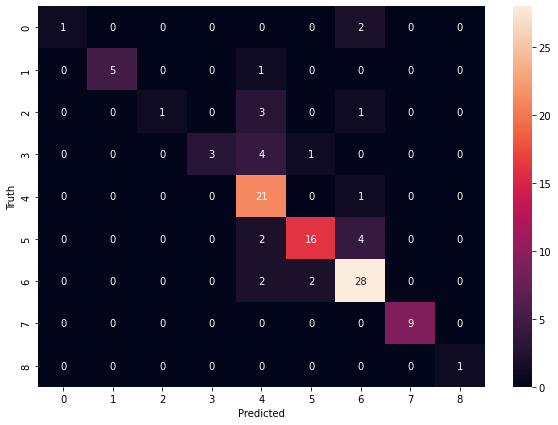

In [ ]:
plt.figure(figsize=(10,7))
sns.heatmap(cm, annot=True)
plt.xlabel("Predicted")
plt.ylabel("Truth")

In [ ]:
y

ERR1001626    3.0
ERR1001627    3.0
ERR1328122    4.0
ERR1328123    4.0
ERR1328124    4.0
             ... 
ERR3587200    2.0
ERR3587201    2.0
ERR3587202    2.0
ERR3587203    2.0
ERR3587204    2.0
Name: Plastic_count, Length: 539, dtype: float64

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn import preprocessing
from sklearn import utils

X = Metatranscriptomic_diamond_norm_counts.copy()
dummies = pd.get_dummies(Metatranscriptomic_env.Feature).drop("ZZZ", axis=1)
X = pd.concat([X, dummies], axis=1)

# X = X.loc[keep]
# X = X.drop(["PEG", "PHA", "PHB"], axis=1)

# y = Metatranscriptomic_env.loc[keep].Plastic_count
y = Metatranscriptomic_env.Plastic_count.round().astype("string")



# #convert y values to categorical values
# lab = preprocessing.LabelEncoder()
# y_transformed = lab.fit_transform(y)

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=10)


for n_estimator in [10, 50, 100, 200, 300, 400, 500, 800, 1000]:
  model = RandomForestClassifier(n_estimators=n_estimator)
  model.fit(X_train, y_train)
  print(n_estimator, model.score(X_test, y_test))

10 0.8055555555555556
50 0.8425925925925926
100 0.8703703703703703
200 0.8703703703703703
300 0.8703703703703703
400 0.8796296296296297
500 0.8796296296296297
800 0.8703703703703703
1000 0.8796296296296297


In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn import preprocessing
from sklearn import utils

X = Metatranscriptomic_diamond_norm_counts.copy()
dummies = pd.get_dummies(Metatranscriptomic_env.Feature).drop("ZZZ", axis=1)
X = pd.concat([X, dummies], axis=1)
X

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PBAT,PEF,PMCL,LDPE,PS,NR,DCM,MES,MIX,SRF
ERR1001626,73.325913,134.245674,0.0,35.922291,0.370333,14.072650,0.185166,0.555499,0.555499,0.555499,...,33.515127,0.000000,0.0,19.997976,30.737630,0.740666,0,0,0,1
ERR1001627,12.278030,17.815181,0.0,6.018642,0.240746,16.129961,0.000000,0.000000,0.000000,0.000000,...,21.907858,0.000000,0.0,6.018642,13.241013,0.000000,0,0,0,1
ERR1328122,14.930205,20.902287,0.0,10.890267,0.351299,15.808452,0.000000,0.000000,0.000000,0.000000,...,18.618844,0.000000,0.0,2.459093,0.000000,0.878247,0,0,0,1
ERR1328123,8.448007,11.474655,0.0,5.288319,0.000000,9.379283,0.000000,0.000000,0.000000,0.000000,...,21.253057,0.000000,0.0,1.596474,0.000000,0.033260,1,0,0,0
ERR1328124,10.116983,12.093865,0.0,5.465497,0.000000,10.233270,0.000000,0.000000,0.000000,0.000000,...,22.792284,0.000000,0.0,1.162872,0.000000,0.000000,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3587200,13.641812,15.554215,0.0,5.099743,0.212489,9.732009,0.000000,0.084996,0.084996,0.084996,...,17.934095,0.424979,0.0,3.739811,0.042498,0.084996,0,0,0,1
ERR3587201,13.802977,15.413324,0.0,1.610347,0.460099,12.422679,0.000000,0.460099,0.460099,0.460099,...,23.695110,0.000000,0.0,2.530546,0.460099,1.380298,0,0,0,1
ERR3587202,6.253687,7.742660,0.0,3.573535,0.000000,11.911784,0.000000,0.000000,0.000000,0.000000,...,8.933838,0.000000,0.0,1.488973,0.000000,1.191178,0,0,0,1
ERR3587203,6.631980,8.842639,0.0,5.895093,0.000000,12.035815,0.000000,0.000000,0.000000,0.000000,...,13.263959,0.245629,0.0,3.193175,0.000000,1.719402,0,0,0,1


In [ ]:
Metatranscriptomic_env.columns

Index(['Device', 'Year', 'Latitude', 'Longitude', 'Feature', 'Depth top',
       'Sample material', 'Biome', 'Region', 'Province', 'Season',
       'Season period', 'SSD', 'PAR', 'SST', 'Fe', 'NH4', 'NO2', 'NO3',
       'SSChla', 'Chl', 'Ssphi', 'POC', 'PIC', 'Bathy depth', 'SST.1', 'SSM',
       'u', 'v', 'OW', 'MLE', 'RT', 'Age', 'Lat_plastic', 'Lon_plastic',
       'Plastic_count'],
      dtype='object')

# Metagenomics data analysis

## Diamond alignment

In [ ]:
# Use diamond to align sequences to PlasticDB database
base_count_mean = Metagenomic_ENA.base_count.mean()
base_count_max = Metagenomic_ENA.base_count.max()
for index, row in Metagenomic_ENA.iloc[100:].iterrows():
    url1, url2 = row["fastq_ftp"].split(";")
    r1 = url1.split("/")[-1]
    r2 = url2.split("/")[-1]
    sample = r1.split("/")[-1].split("_")[0]
    db_path = path2+"databases/PlasticDB/PlasticDB"
    base_count = row["base_count"]
    #Sending Diamond jobs
    if base_count > base_count_max*0.8:
        job_time = "00:25:00"
    elif base_count > base_count_mean:
        job_time = "00:20:00"
    else:
        job_time = "00:15:00"
    job_memory = "8GB"
    job_cpus = 8
    # Read 1
    job_name = sample[-5:]+"_1"
    job_command = path2+"tools/"+"diamond blastx -q "+path+"metagenomic_data/"+r1+" -d "+db_path+" -o "+path2+"metagenomic_data/"+r1+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
    run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
    time.sleep(1)
    # Read 2
    job_name = sample[-5:]+"_2"
    job_command = path2+"tools/"+"diamond blastx -q "+path+"metagenomic_data/"+r2+" -d "+db_path+" -o "+path2+"metagenomic_data/"+r2+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
    run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
    time.sleep(1)

In [ ]:
# Redo jobs that ran out of time
base_count_mean = Metagenomic_ENA.base_count.mean()
base_count_max = Metagenomic_ENA.base_count.max()
for index, row in Metagenomic_ENA.iloc[50:].iterrows():
    url1, url2 = row["fastq_ftp"].split(";")
    r1 = url1.split("/")[-1]
    r2 = url2.split("/")[-1]
    sample = r1.split("/")[-1].split("_")[0]
    db_path = path2+"databases/PlasticDB/PlasticDB"
    base_count = row["base_count"]
    job_memory = "8GB"
    job_cpus = 8
    #Sending Diamond jobs
    # Read 1
    if os.path.getsize(path2+"metagenomic_data/"+r1+".tsv") == 0:
        job_time = "00:45:00"
        job_name = sample[-5:]+"_1"
        job_command = path2+"tools/"+"diamond blastx -q "+path+"metagenomic_data/"+r1+" -d "+db_path+" -o "+path2+"metagenomic_data/"+r1+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
        run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
        time.sleep(1)
    # Read 2
    if os.path.getsize(path2+"metagenomic_data/"+r2+".tsv") == 0:
        job_time = "00:45:00"
        job_name = sample[-5:]+"_2"
        job_command = path2+"tools/"+"diamond blastx -q "+path+"metagenomic_data/"+r2+" -d "+db_path+" -o "+path2+"metagenomic_data/"+r2+".tsv -f 6 --threads 8 --memory-limit 6 --quiet --header"
        run_command(run_on_slurm, account, job_name, job_time, job_memory, job_cpus, job_command)
        time.sleep(1)

In [ ]:
# Parse diamond results
Metagenomic_diamond_raw_counts = pd.DataFrame(data=None, columns=PlasticDB_plastics)
for index, row in Metagenomic_ENA.iterrows():
  url1, url2 = row["fastq_ftp"].split(";")
  r1 = path+"metagenomic_data/"+url1.split("/")[-1]+".tsv"
  r2 = path+"metagenomic_data/"+url2.split("/")[-1]+".tsv"
  sample = r1.split("/")[-1].split("_")[0]
  df = parse_diamond(sample, r1, r2, 1e-10, 30, PlasticDB_plastics)
  Metagenomic_diamond_raw_counts = pd.concat([Metagenomic_diamond_raw_counts, df])


Metagenomic_diamond_raw_counts

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
ERR1701760,263,385,1,155,4,348,16,14,14,14,...,27,0,0,97,632,0,0,86,5,44
ERR315858,282,878,0,194,12,402,2,2,2,2,...,0,0,0,524,1465,3,0,59,6,11
ERR315859,236,726,0,219,16,422,6,3,3,3,...,2,0,0,330,1685,4,0,31,14,17
ERR315860,211,669,0,229,7,404,3,2,2,2,...,0,0,0,288,1628,2,0,33,4,12
ERR315861,263,880,0,181,10,407,0,1,1,1,...,0,0,0,538,1494,0,0,45,9,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3589589,225,1684,0,4855,20,4595,1,1,1,1,...,0,0,0,212,4165,14,0,728,100,14
ERR3589590,460,1807,0,6155,16,6461,3,1,1,1,...,0,0,0,330,2959,4,0,770,93,77
ERR3589591,667,2005,0,2078,34,1865,2,1,1,1,...,22,0,0,559,5161,17,0,448,99,14
ERR3589592,73,1425,0,4066,20,4714,3,3,3,3,...,4,0,0,257,5176,3,0,859,43,0


In [ ]:
Metagenomic_diamond_raw_counts.to_csv(path+"Metagenomic_diamond_raw_counts.tsv", sep = "\t")

In [ ]:
columns = Metagenomic_diamond_raw_counts.columns
Metagenomic_diamond_norm_counts = pd.DataFrame(columns=columns)

# Normalize count table by number of bases sequenced in each sample
for index, row in Metagenomic_diamond_raw_counts.iterrows():
  base_count = Metagenomic_ENA.loc[Metagenomic_ENA['run_accession'] == index]["base_count"].iloc[0]
  Metagenomic_diamond_norm_counts = Metagenomic_diamond_norm_counts.append(row.div(base_count/1000000000))

Metagenomic_diamond_norm_counts

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
ERR1701760,6.946299,10.168537,0.026412,4.093827,0.105647,9.191301,0.422589,0.369765,0.369765,0.369765,...,0.713118,0.0,0.0,2.561943,16.692248,0.000000,0.0,2.271414,0.132059,1.162119
ERR315858,35.666808,111.047721,0.000000,24.536740,1.517737,50.844173,0.252956,0.252956,0.252956,0.252956,...,0.000000,0.0,0.0,66.274494,185.290332,0.379434,0.0,7.462205,0.758868,1.391258
ERR315859,29.907469,92.003484,0.000000,27.753117,2.027625,53.478609,0.760359,0.380180,0.380180,0.380180,...,0.253453,0.0,0.0,41.819765,213.534256,0.506906,0.0,3.928523,1.774172,2.154352
ERR315860,27.215016,86.288368,0.000000,29.536676,0.902868,52.108372,0.386943,0.257962,0.257962,0.257962,...,0.000000,0.0,0.0,37.146562,209.981260,0.257962,0.0,4.256377,0.515924,1.547773
ERR315861,33.158837,110.949720,0.000000,22.820340,1.260792,51.314245,0.000000,0.126079,0.126079,0.126079,...,0.000000,0.0,0.0,67.830624,188.362365,0.000000,0.0,5.673565,1.134713,1.639030
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3589589,8.505476,63.658759,0.000000,183.529260,0.756042,173.700711,0.037802,0.037802,0.037802,0.037802,...,0.000000,0.0,0.0,8.014048,157.445802,0.529230,0.0,27.519939,3.780211,0.529230
ERR3589590,13.686748,53.765116,0.000000,183.134638,0.476061,192.239300,0.089261,0.029754,0.029754,0.029754,...,0.000000,0.0,0.0,9.818754,88.041494,0.119015,0.0,22.910426,2.767103,2.291043
ERR3589591,16.803257,50.510540,0.000000,52.349577,0.856538,46.983619,0.050385,0.025192,0.025192,0.025192,...,0.554230,0.0,0.0,14.082490,130.017404,0.428269,0.0,11.286146,2.494037,0.352692
ERR3589592,1.813163,35.393944,0.000000,100.990721,0.496757,117.085652,0.074514,0.074514,0.074514,0.074514,...,0.099351,0.0,0.0,6.383329,128.560741,0.074514,0.0,21.335718,1.068028,0.000000


In [ ]:
Metagenomic_diamond_norm_counts.to_csv(path+"Metagenomic_diamond_norm_counts.tsv", sep = "\t")

## Statistical analysis

### Data desciption

In [ ]:
Metagenomic_diamond_norm_counts = pd.read_csv(path+"Metagenomic_diamond_norm_counts.tsv", sep = "\t", index_col=0)
Metagenomic_diamond_norm_counts

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
ERR1701760,6.946299,10.168537,0.026412,4.093827,0.105647,9.191301,0.422589,0.369765,0.369765,0.369765,...,0.713118,0.0,0.0,2.561943,16.692248,0.000000,0.0,2.271414,0.132059,1.162119
ERR315858,35.666808,111.047721,0.000000,24.536740,1.517737,50.844173,0.252956,0.252956,0.252956,0.252956,...,0.000000,0.0,0.0,66.274494,185.290332,0.379434,0.0,7.462205,0.758868,1.391258
ERR315859,29.907469,92.003484,0.000000,27.753117,2.027625,53.478609,0.760359,0.380180,0.380180,0.380180,...,0.253453,0.0,0.0,41.819765,213.534256,0.506906,0.0,3.928523,1.774172,2.154352
ERR315860,27.215016,86.288368,0.000000,29.536676,0.902868,52.108372,0.386943,0.257962,0.257962,0.257962,...,0.000000,0.0,0.0,37.146562,209.981260,0.257962,0.0,4.256377,0.515924,1.547773
ERR315861,33.158837,110.949720,0.000000,22.820340,1.260792,51.314245,0.000000,0.126079,0.126079,0.126079,...,0.000000,0.0,0.0,67.830624,188.362365,0.000000,0.0,5.673565,1.134713,1.639030
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR3589589,8.505476,63.658759,0.000000,183.529260,0.756042,173.700711,0.037802,0.037802,0.037802,0.037802,...,0.000000,0.0,0.0,8.014048,157.445802,0.529230,0.0,27.519939,3.780211,0.529230
ERR3589590,13.686748,53.765116,0.000000,183.134638,0.476061,192.239300,0.089261,0.029754,0.029754,0.029754,...,0.000000,0.0,0.0,9.818754,88.041494,0.119015,0.0,22.910426,2.767103,2.291043
ERR3589591,16.803257,50.510540,0.000000,52.349577,0.856538,46.983619,0.050385,0.025192,0.025192,0.025192,...,0.554230,0.0,0.0,14.082490,130.017404,0.428269,0.0,11.286146,2.494037,0.352692
ERR3589592,1.813163,35.393944,0.000000,100.990721,0.496757,117.085652,0.074514,0.074514,0.074514,0.074514,...,0.099351,0.0,0.0,6.383329,128.560741,0.074514,0.0,21.335718,1.068028,0.000000


In [ ]:
Metagenomic_env = pd.read_csv(path+"Metagenomic_env.tsv", sep = "\t", index_col=0)
Metagenomic_env

,Device,Year,Latitude,Longitude,Feature,Depth top,Sample material,Biome,Region,Province,...,SSM,u,v,OW,MLE,RT,Age,Lat_plastic,Lon_plastic,Plastic_count
ERR1701760,High Volume Peristaltic Pump,2010,18.5839,66.4727,DCM,23.0,1.6-20,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,0.000096,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.6,66.4,4.027151
ERR315858,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000071,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
ERR315859,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000049,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
ERR315860,High Volume Peristaltic Pump,2009,42.1735,17.7252,DCM,53.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000049,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
ERR315861,High Volume Peristaltic Pump,2009,42.2038,17.7150,SRF,3.0,0.22-1.6,Westerlies Biome,Mediterranean Sea,"Mediterranean Sea, Black Sea Province",...,0.000071,-11.278648,4.980596,-0.354776,0.078584,3.583333,11.0,42.2,17.8,3.815990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR599172,Rosette Vertical Sampling System,2010,18.7341,66.3896,MES,262.0,0.22-1.6,Trades Biome,Indian Ocean,Indian Monsoon Gyres Province,...,0.000012,-0.557961,15.046586,0.403157,NaN,2.250000,120.0,18.8,66.4,4.045046
ERR599173,High Volume Peristaltic Pump,2010,-34.9449,17.9189,SRF,3.0,0.22-3,Coastal Biome,South Atlantic Ocean,Benguela Current Coastal Province,...,NaN,-8.003876,9.877117,0.143048,0.098545,0.000000,9.0,-35.0,18.0,2.973336
ERR599174,High Volume Peristaltic Pump,2010,-31.0266,4.6650,SRF,3.0,0.22-3,Trades Biome,South Atlantic Ocean,South Atlantic Gyral Province,...,0.000009,-1.471021,-22.689750,0.069036,0.120437,6.388889,120.0,-31.0,4.6,3.609397
ERR599175,Rosette Vertical Sampling System,2011,6.3559,-103.0598,MES,440.0,0.22-3,Trades Biome,North Pacific Ocean,North Pacific Equatorial Countercurrent Province,...,0.000029,52.020196,1.040314,-0.002795,0.020154,0.000000,120.0,6.4,-103.0,2.711999


In [ ]:
Metagenomic_diamond_norm_counts.describe()

,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,PEA,...,PE,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR
count,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,...,287.000000,287.0,287.0,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000
mean,32.459732,55.876198,0.057537,49.047937,1.899758,49.544470,0.180187,0.295781,0.295781,0.295781,...,0.965174,0.0,0.0,13.842819,108.644216,0.605163,0.000284,7.082425,1.018019,1.749727
std,23.942792,31.571540,0.231669,45.332711,1.477479,43.681472,0.291064,0.419795,0.419795,0.419795,...,3.232075,0.0,0.0,11.746439,30.924299,0.812383,0.002778,5.807842,1.605247,1.678383
min,1.813163,10.168537,0.000000,4.093827,0.000000,9.191301,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,2.021163,16.692248,0.000000,0.000000,0.268888,0.000000,0.000000
25%,18.145880,34.006380,0.000000,22.772305,0.749411,27.334191,0.000000,0.054876,0.054876,0.054876,...,0.104602,0.0,0.0,5.612276,91.179336,0.106709,0.000000,3.442166,0.144992,0.627446
50%,24.667928,44.363038,0.000000,31.804230,1.644870,34.564219,0.095506,0.147876,0.147876,0.147876,...,0.321009,0.0,0.0,9.818754,105.477749,0.299411,0.000000,5.255672,0.310441,1.313721
75%,38.212433,69.927555,0.029078,55.363107,2.645235,44.862650,0.203911,0.366274,0.366274,0.366274,...,0.701142,0.0,0.0,19.624877,128.557289,0.892234,0.000000,7.968540,0.996736,2.296930
max,134.667686,182.660957,2.953278,237.666239,10.046896,235.955463,2.715128,3.402502,3.402502,3.402502,...,35.815874,0.0,0.0,74.225244,213.534256,6.623634,0.029206,34.493446,8.605888,11.533463


In [ ]:
df = Metagenomic_diamond_norm_counts.describe().T.sort_values("mean", ascending=False)
df["Plastic"] = df.index
df

,count,mean,std,min,25%,50%,75%,max,Plastic
PEG,287.0,979.187750,314.971307,141.435109,754.346271,980.790314,1185.139319,2020.360227,PEG
PBAT,287.0,108.644216,30.924299,16.692248,91.179336,105.477749,128.557289,213.534256,PBAT
PLA,287.0,101.346385,29.426028,17.748720,83.107589,97.053135,123.035374,198.630921,PLA
PET,287.0,82.744857,43.452367,12.862539,55.277128,70.749487,92.101835,281.990541,PET
PHA,287.0,55.876198,31.571540,10.168537,34.006380,44.363038,69.927555,182.660957,PHA
PU,287.0,49.544470,43.681472,9.191301,27.334191,34.564219,44.862650,235.955463,PU
PCL,287.0,49.047937,45.332711,4.093827,22.772305,31.804230,55.363107,237.666239,PCL
PHB,287.0,32.459732,23.942792,1.813163,18.145880,24.667928,38.212433,134.667686,PHB
PBSA,287.0,32.063674,16.002726,4.041003,20.139304,27.415010,40.367789,82.994339,PBSA
Nylon,287.0,27.675669,14.288608,3.454306,17.811493,24.279274,39.777671,65.360438,Nylon


Text(0.5, 0, 'Mean hit per billion nucleotides')

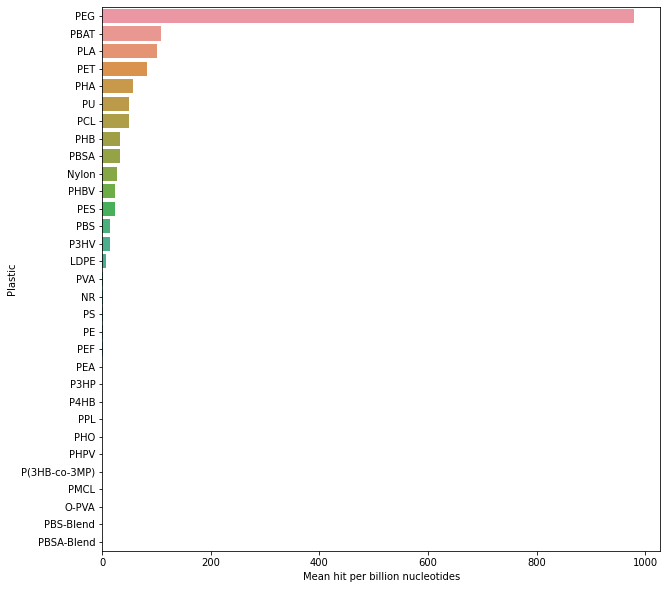

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
ax = sns.barplot(y="Plastic", x="mean", data=df)
plt.xlabel("Mean hit per billion nucleotides")

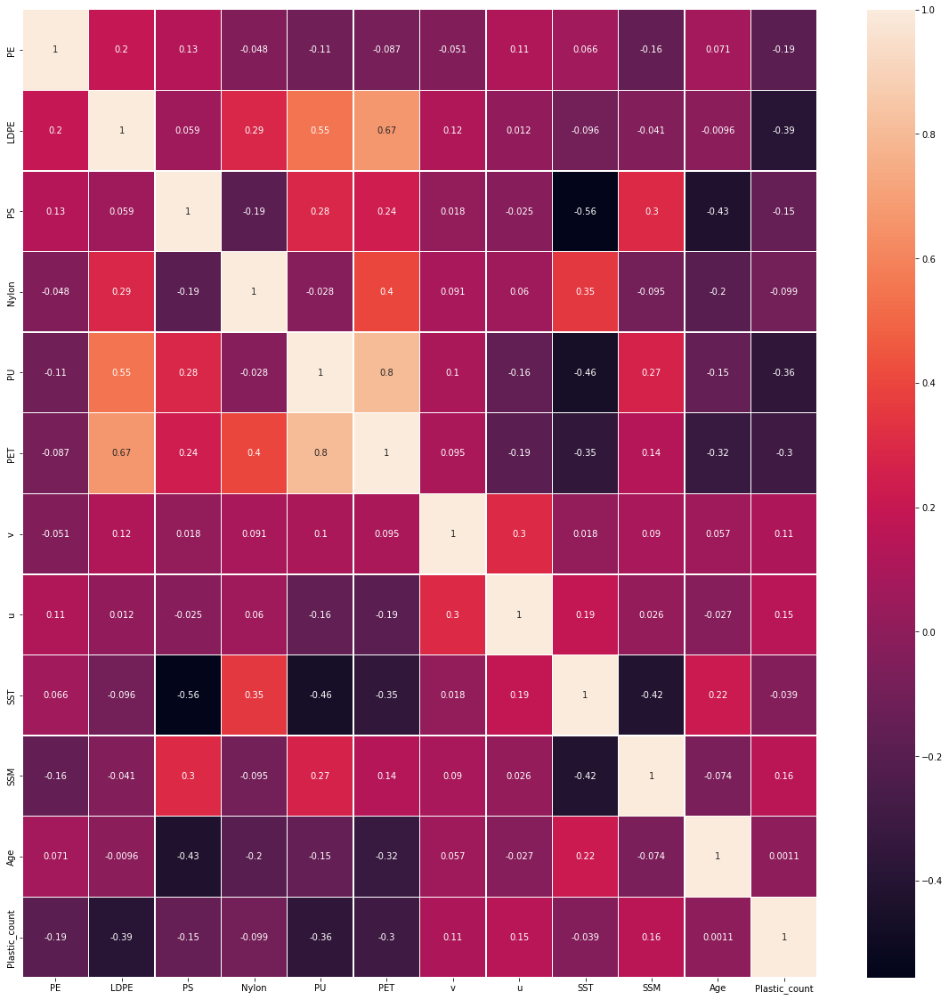

In [ ]:
df = Metagenomic_diamond_norm_counts.copy()
df_env = Metagenomic_env.copy()
df_env = df_env[df_env.Feature == "SRF"]
df_env = df_env[df_env.Biome != "Polar Biome"]
df = df.loc[df_env.index]
df = df[["PE", "LDPE", "PS", "Nylon", "PU", "PET"]]
# df = df.drop(["ERR3587157", "ERR3587132"])
# df_env = df_env.drop(["ERR3587157", "ERR3587132"])
df["v"] = df_env["v"]
df["u"] = df_env["u"]
df["SST"] = df_env["SST"]
df["SSM"] = df_env["SSM"]
df["Age"] = df_env["Age"]
df["Plastic_count"] = df_env["Plastic_count"]

corrmat = df.corr()
fig, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corrmat, vmax=1, annot=True, linewidths=.5)
plt.show()

### Kmeans

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
km = KMeans(n_clusters=5)
y_predicted = km.fit_predict(Metagenomic_diamond_norm_counts)
y_predicted

array([2, 3, 3, 3, 3, 0, 4, 4, 0, 4, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0,
       1, 1, 4, 1, 1, 2, 0, 1, 0, 0, 1, 1, 0, 0, 4, 0, 1, 0, 1, 0, 4, 0,
       2, 0, 1, 0, 0, 1, 1, 4, 0, 2, 1, 1, 2, 0, 0, 1, 0, 0, 0, 0, 2, 0,
       0, 1, 1, 2, 0, 0, 4, 2, 2, 1, 0, 2, 0, 2, 1, 1, 1, 0, 2, 0, 1, 1,
       0, 1, 2, 1, 1, 0, 0, 1, 4, 0, 0, 1, 2, 0, 1, 1, 0, 0, 2, 1, 0, 2,
       1, 1, 0, 2, 0, 1, 1, 2, 0, 4, 2, 0, 1, 0, 1, 1, 1, 1, 0, 2, 1, 2,
       0, 0, 0, 0, 1, 4, 0, 2, 1, 2, 0, 1, 0, 2, 0, 0, 1, 0, 0, 1, 1, 0,
       2, 2, 1, 0, 0, 4, 4, 0, 4, 0, 0, 1, 1, 0, 2, 1, 1, 1, 1, 0, 2, 1,
       4, 0, 2, 1, 2, 2, 0, 4, 2, 1, 1, 0, 0, 4, 0, 4, 0, 1, 2, 2, 2, 1,
       1, 1, 1, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 2, 2, 2, 0,
       0, 2, 0, 2, 1, 1, 1, 1, 1, 1, 0, 1, 0, 2, 2, 1, 2, 4, 0, 0, 1, 2,
       0, 1, 2, 4, 4, 0, 4, 0, 0, 1, 4, 1, 4, 0, 0, 1, 0, 4, 0, 1, 4, 1,
       4, 0, 0, 1, 0, 4, 4, 1, 0, 2, 1, 4, 4, 1, 1, 4, 4, 4, 4, 0, 4, 4,
       1], dtype=int32)

### PCA from sklearn

In [ ]:
import random as rd
from sklearn.decomposition import PCA
from sklearn import preprocessing
from matplotlib import pyplot as plt

Text(0.5, 1.0, 'Scree Plot')

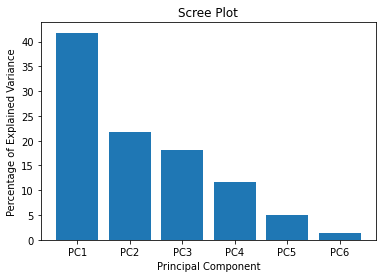

In [ ]:
df = Metagenomic_diamond_norm_counts.copy()
df_env = Metagenomic_env.copy()
df_env = df_env[df_env.Feature == "SRF"]
df_env = df_env[df_env.Biome != "Polar Biome"]
df = df.loc[df_env.index]
df = df[["PE", "LDPE", "PS", "Nylon", "PU", "PET"]]
# df = df.drop(["ERR3587157", "ERR3587132"])
# df_env = df_env.drop(["ERR3587157", "ERR3587132"])

scaled_data = preprocessing.scale(df)
# scaled_data = df.copy()
pca = PCA()
pca.fit(scaled_data)
pca_data = pca.transform(scaled_data)

per_var = np.round(pca.explained_variance_ratio_*100, decimals=1)
labels = ["PC" + str(i) for i in range(1, len(per_var)+1)]

plt.bar(x=range(1, len(per_var)+1), height = per_var, tick_label=labels)
plt.ylabel("Percentage of Explained Variance")
plt.xlabel("Principal Component")
plt.title("Scree Plot")

In [ ]:
pca_df = pd.DataFrame(pca_data, index=df.index.to_list(), columns=labels)
pca_df

,PC1,PC2,PC3,PC4,PC5,PC6
ERR315858,2.312851,-1.458331,-0.494920,-1.015662,-0.394571,-0.162103
ERR315861,1.953969,-0.825100,-0.829512,-1.059899,-0.733246,-0.395386
ERR315862,-0.028131,-0.255546,0.240154,0.523572,0.762489,-0.382010
ERR315863,2.800260,0.317376,3.742542,0.838786,0.149002,-0.600206
ERR3589591,2.440870,1.137573,0.307393,-0.045664,1.004260,-0.686219
...,...,...,...,...,...,...
ERR599169,2.661052,-0.620430,0.422542,0.819382,0.673481,-0.193229
ERR599170,-1.050682,-0.074164,-0.657047,-0.061954,-0.189620,0.061641
ERR599171,-1.704940,1.143127,-0.295860,0.142120,-0.398840,-0.245506
ERR599173,-0.115870,0.778595,-1.004783,-0.961598,-0.223394,-0.527193


In [ ]:
from sklearn.preprocessing import LabelEncoder
column = LabelEncoder()
cmap = column.fit_transform(df_env["Sample material"])
mapping = dict(zip(column.transform(column.classes_), column.classes_))
mapping

{0: '0.22-1.6', 1: '0.22-3'}

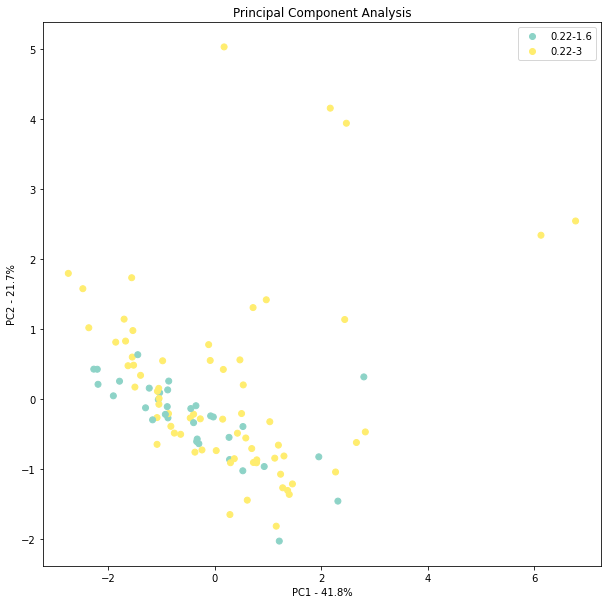

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
scatter = plt.scatter(pca_df.PC1, pca_df.PC2, c=cmap, label=labels, cmap="Set3")
plt.title("Principal Component Analysis")
plt.xlabel("PC1 - {0}%".format(per_var[0]))
plt.ylabel("PC2 - {0}%".format(per_var[1]))
handles, labels = scatter.legend_elements()
labels = [int(''.join(i for i in x if i.isdigit())) for x in labels]
labels = [mapping[x] for x in labels]
plt.legend(handles, labels)

# for sample in pca_df.index:
#   plt.annotate(sample, (pca_df.PC1.loc[sample], pca_df.PC2.loc[sample]))

### PCA using PCA library

In [ ]:
# https://erdogant.github.io/pca/pages/html/Examples.html#
from pca import pca

# Initialize to reduce the data up to the nubmer of componentes that explains 95% of the variance.
model = pca(n_components=0.95)

# Reduce the data towards 3 PCs
# model = pca(n_components=3)
Metagenomic_diamond_norm_counts = Metagenomic_diamond_norm_counts

# Fit transform
results = model.fit_transform(Metagenomic_diamond_norm_counts)

[pca] >Processing dataframe..
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [31] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [2] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [31] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[2]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]


[0.91847232 0.96404336 0.98963772 0.99460506 0.99670582 0.99776174
 0.99877455 0.99930661 0.99955133 0.99974461 0.99983147 0.99988419
 0.99992488 0.99996368 0.99997947 0.99998783 0.99999336 0.99999612
 0.99999829 0.99999928 0.99999972 0.9999999  0.99999996 0.99999999
 1.         1.         1.         1.         1.         1.
 1.        ]
[9.18472317e-01 4.55710427e-02 2.55943643e-02 4.96733678e-03
 2.10076303e-03 1.05591362e-03 1.01280958e-03 5.32067281e-04
 2.44712834e-04 1.93285545e-04 8.68550942e-05 5.27238853e-05
 4.06881193e-05 3.88013833e-05 1.57869180e-05 8.36247943e-06
 5.52622930e-06 2.76813018e-06 2.16648490e-06 9.92708661e-07
 4.38152841e-07 1.73433830e-07 6.72652999e-08 2.94968606e-08
 7.45227124e-09 5.24247312e-11 2.80651058e-11 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00]


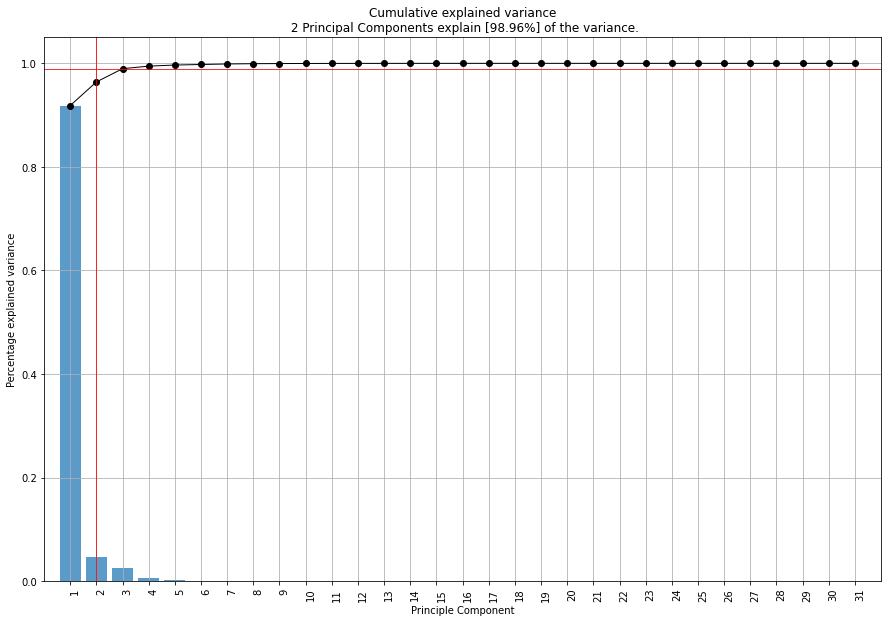

<Figure size 432x288 with 0 Axes>

In [ ]:
# Cumulative explained variance
print(model.results['explained_var'])
# [0.92461872 0.97768521 0.99478782]

# Explained variance per PC
print(model.results['variance_ratio'])
[0.92461872, 0.05306648, 0.01710261]

# Make plot
fig, ax = model.plot()

[pca] >Plot PC1 vs PC2 with loadings.


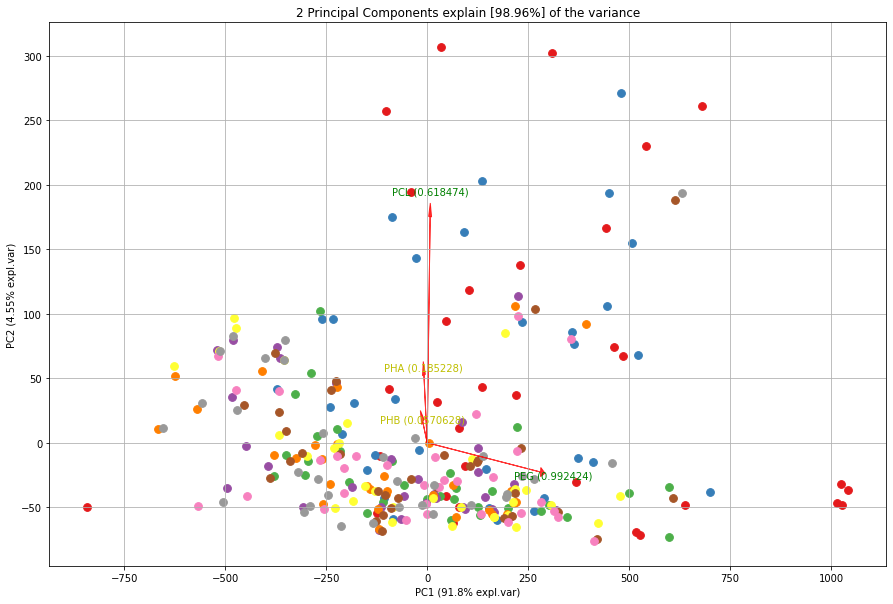

In [ ]:
# 2D plot
fig, ax = model.biplot(n_feat=4, PC=[0,1], label=False, legend=False)

In [ ]:
# 3d Plot
fig, ax = model.biplot3d(n_feat=4, PC=[0,1,2], label=False, legend=False)

[pca] >Requires 3 PCs to make 3d plot. Try to use biplot() instead.


# Metataxonomic data analysis

# Multiomics integrated data analysis

In [ ]:
# Create a df for the results from diamond
l1 = ["File"]
l2 = ["Total"]
l3 = l1 + plastic_list + l2
df_diamond = pd.DataFrame(columns=l3)
df_diamond

,File,PHB,PHA,PHO,PCL,PVA,PU,PPL,P3HP,P4HB,...,PBS-Blend,PBSA-Blend,P3HV,PBAT,PEF,PMCL,LDPE,PS,NR,Total


In [ ]:
# Use diamond to search all downloaded sequences against the PlasticDB database
df_tmp = pd.read_table(r2+".tsv", header=None)
df_tmp

,0,1,2,3,4,5,6,7,8,9,10,11
0,ERR1001626.5750,00035||PEG_aldehyde_dehydrogenase||Streptomyce...,71.4,21,6,0,70,8,444,464,9.500000e-06,32.3
1,ERR1001626.8318,00035||PEG_aldehyde_dehydrogenase||Streptomyce...,51.6,31,14,1,100,8,426,455,3.300000e-05,30.8
2,ERR1001626.9642,00089||Carboxylesterase||Uncultured_bacterium|...,56.0,25,11,0,97,23,107,131,1.300000e-05,32.0
3,ERR1001626.9926,00032||PEG_dehydrogenase||Sphingomonas_macrogo...,74.2,31,8,0,94,2,86,116,1.500000e-10,45.8
4,ERR1001626.15006,00035||PEG_aldehyde_dehydrogenase||Streptomyce...,59.4,32,13,0,100,5,345,376,7.500000e-10,43.9
...,...,...,...,...,...,...,...,...,...,...,...,...
9085,ERR1001626.27590611,00104||Alkane_monooxygenase||Paenibacillus_sp....,35.5,31,20,0,97,5,36,66,1.400000e-05,31.6
9086,ERR1001626.27591924,00035||PEG_aldehyde_dehydrogenase||Streptomyce...,40.0,30,18,0,98,9,376,405,6.900000e-06,32.7
9087,ERR1001626.27593319,00026||PHB_depolymerase||Marinobacter_sp.||PHB...,50.0,32,16,0,96,1,368,399,1.400000e-06,34.7
9088,ERR1001626.27603258,00028||PHB_depolymerase||Azospirillum_brasilen...,48.4,31,16,0,95,3,404,434,1.800000e-06,34.3


In [ ]:
for index, row in df.iterrows():
    if row["sample_alias"] in geo_dic:
        df.loc[index, "Latitude"] = geo_dic[row["sample_alias"]][0]
        df.loc[index, "Longitude"] = geo_dic[row["sample_alias"]][1]

In [ ]:
# pd.set_option('display.max_columns', None)
# df
for index, row in df.iterrows():
    print(index, row["fastq_ftp"],row["Latitude"],row["Longitude"], row["sample_title"])

In [ ]:
df["Latitude"].count()

In [ ]:
from folium.plugins import HeatMap
import branca
import branca.colormap as cm

# Define color gradient
colormap = cm.LinearColormap(colors=['green', 'red'],
                             index=[df["base_count"].min(),df["base_count"].max()],
                             vmin=df["base_count"].min(),
                             vmax=df["base_count"].max())

# Make an empty map
m = folium.Map(location=[20,0], tiles="OpenStreetMap", zoom_start=2)

# I can add marker one by one on the map
for index, row in df.iterrows():
    folium.Circle(location=[row["Latitude"], row["Longitude"]],
                  radius=row["base_count"]/100000,
                  popup=row["base_count"]/100000,
                  color=colormap(row["base_count"]),
                  fill=True,
                  opacity=1,
                  fill_opacity=1,
                 fill_color=colormap(row["base_count"])).add_to(m)

# # Save it as html
# m.save('mymap.html')
m

In [ ]:
df3 = pd.DataFrame(df.groupby(["Latitude", "Longitude"])["base_count"].sum())

In [ ]:
df3.reset_index(level=0, inplace=True)
df3.reset_index(level=0, inplace=True)
df3

,Longitude,Latitude,base_count
0,-53.0063,-64.3595,23829885389
1,-53.1081,-64.3183,11615097713
2,-56.0916,-63.8768,22774550326
3,-56.7938,-63.4015,21571216644
4,-49.2139,-62.2231,13578220553
...,...,...,...
150,-16.8344,43.6792,24900976817
151,-16.8794,43.7056,22604847010
152,-16.9692,43.7899,104602399189
153,-16.5455,44.0342,17994761247


In [ ]:
import numpy as np

df3["base_count"] = np.log2(df3['base_count'])
df3

,Longitude,Latitude,base_count
0,-53.0063,-64.3595,34.472053
1,-53.1081,-64.3183,33.435282
2,-56.0916,-63.8768,34.406704
3,-56.7938,-63.4015,34.328388
4,-49.2139,-62.2231,33.660575
...,...,...,...
150,-16.8344,43.6792,34.535483
151,-16.8794,43.7056,34.395913
152,-16.9692,43.7899,36.606125
153,-16.5455,44.0342,34.066858


In [ ]:
from folium.plugins import HeatMap
import branca
import branca.colormap as cm

# Define color gradient
colormap = cm.LinearColormap(colors=['green', 'gray', 'red'],
                             vmin=df3["base_count"].min(),
                             vmax=df3["base_count"].max(),)

# Make an empty map
m = folium.Map(location=[20,0], tiles="OpenStreetMap", zoom_start=2)

# I can add marker one by one on the map
for index, row in df3.iterrows():
    folium.Circle(location=[row["Latitude"], row["Longitude"]],
                  radius=100000,
                  popup=row["base_count"]/100000,
                  color=colormap(row["base_count"]),
                  fill=True,
                  opacity=1,
                  fill_opacity=1,
                 fill_color=colormap(row["base_count"])).add_to(m)

# # Save it as html
# m.save('mymap.html')
m

In [ ]:
import rasterio
from rasterio.plot import show

img = rasterio.open("globalplastic_wd_cd_rasters_360/count_density_size1_360.tif")
img.profile

<Figure size 640x480 with 1 Axes>

{'driver': 'GTiff', 'dtype': 'float64', 'nodata': None, 'width': 1801, 'height': 901, 'count': 1, 'crs': CRS.from_epsg(4326), 'transform': Affine(0.19988895058300943, 0.0, 0.0,
       0.0, -0.1997780244173141, 90.0), 'blockxsize': 192, 'blockysize': 96, 'tiled': True, 'compress': 'packbits', 'interleave': 'band'}

In [ ]:
show(img)

NameError: ignored

In [ ]:
import rioxarray as rxr

pre_lidar_dem = rxr.open_rasterio("globalplastic_wd_cd_rasters_360/count_density_size1_360.tif",
                                 masked=True)

ModuleNotFoundError: No module named 'rioxarray'

In [ ]:
from osgeo import gdal

filename=gdal.Open("globalplastic_wd_cd_rasters_360/count_density_size1_360.tif")

metadata=filename.GetMetadata()

print(metadata)

ModuleNotFoundError: No module named 'gdal'

In [ ]:
f = open("xy_data.csv", "w")
for item in px_vals:
        f.write(str(item['x'])+","+str(item['y'])+","+str(item['value'])+"\n")
f.close()

In [ ]:
raster.transform * (277, 676)

(55.36923931149361, -45.04994450610434)

In [ ]:
raster.crs

CRS.from_epsg(4326)

In [ ]:
df_geo = pd.read_csv("geo_info.csv")


In [ ]:
df_geo

,Unnamed: 0,count_density_size1_360,x,y
0,1,0.230901,0.099944,89.900111
1,2,0.230901,0.299833,89.900111
2,3,0.230901,0.499722,89.900111
3,4,0.230901,0.699611,89.900111
4,5,0.230901,0.899500,89.900111
...,...,...,...,...
1622696,1622697,0.230901,359.100500,-89.900111
1622697,1622698,0.230901,359.300389,-89.900111
1622698,1622699,0.230901,359.500278,-89.900111
1622699,1622700,0.230901,359.700167,-89.900111


In [ ]:
df_geo[df_geo['count_density_size1_360'] > 5]

,Unnamed: 0,count_density_size1_360,x,y
169181,169182,5.051087,337.512493,71.320755
180208,180209,5.565906,21.687951,69.922309
189184,189185,5.090780,15.891172,68.923418
189185,189186,5.148767,16.091061,68.923418
189188,189189,5.222097,16.690727,68.923418
...,...,...,...,...
1182329,1182330,5.052762,174.602998,-41.154273
1182330,1182331,5.114635,174.802887,-41.154273
1189385,1189386,5.331610,145.019434,-41.953385
1189386,1189387,5.837888,145.219323,-41.953385


In [ ]:
from folium.plugins import HeatMap
import branca
import branca.colormap as cm

# Define color gradient
colormap = cm.LinearColormap(colors=['green', 'gray', 'red'],
                             vmin=df3["base_count"].min(),
                             vmax=df3["base_count"].max(),)

# Make an empty map
m = folium.Map(location=[20,0], tiles="OpenStreetMap", zoom_start=2)

# I can add marker one by one on the map
for index, row in df_geo[df_geo['count_density_size1_360'] > 5].iterrows():
    folium.Circle(location=[row["x"], row["y"]],
                  radius=1000,
                  popup=[row["x"], row["y"]],
                  color=colormap(row["count_density_size1_360"]),
                  fill=True,
                  opacity=1,
                  fill_opacity=1,
                 fill_color=colormap(row["count_density_size1_360"])).add_to(m)

# # Save it as html
# m.save('mymap.html')
m

In [ ]:
import pyproj

latitude, longitude = 337.912271, 82.308546

geo_input = pyproj.Proj(init='epsg:4326')
geo_output = pyproj.Proj(init='epsg:3857')

easting, northing = pyproj.transform(geo_input, geo_output, latitude, longitude)
print(easting, northing)

-2458794.7450598273 17219445.510596395


In [ ]:
from folium.plugins import HeatMap
import branca
import branca.colormap as cm

# Define color gradient
colormap = cm.LinearColormap(colors=['green', 'gray', 'red'],
                             vmin=df3["base_count"].min(),
                             vmax=df3["base_count"].max(),)

# Make an empty map
m = folium.Map(location=[20,0], tiles="OpenStreetMap", zoom_start=2)

# I can add marker one by one on the map
for item in px_vals:
    if item["value"] > 5:
        folium.Circle(location=[item["converted"][0], item["converted"][0]],
                      radius=1000,
                      popup=[item["converted"][0], item["converted"][0]],
                      color=colormap(item['value']),
                      fill=True,
                      opacity=1,
                      fill_opacity=1,
                     fill_color=colormap(item['value'])).add_to(m)

# # Save it as html
# m.save('mymap.html')
m

In [ ]:
!pip3 install pyproj==1.9.6

    100% |████████████████████████████████| 2.8MB 404kB/s ta 0:00:011  9% |███                             | 266kB 1.5MB/s eta 0:00:02
  Running setup.py bdist_wheel for pyproj ... done
  Stored in directory: /home/victor/.cache/pip/wheels/02/cd/b1/a2d6430f74c7a778a43d62f78bec109ca69c732dc9b929142a
Successfully built pyproj


In [ ]:
!pip3 install gdal

  Using cached https://files.pythonhosted.org/packages/4e/fb/e887581ff6a8243105c54c5f2877bf577fa2662167a31174174d550e0f3b/GDAL-3.3.2.tar.gz
  Running setup.py bdist_wheel for gdal ... error
  Complete output from command /usr/bin/python3 -u -c "import setuptools, tokenize;__file__='/tmp/pip-build-diwmn2ad/gdal/setup.py';f=getattr(tokenize, 'open', open)(__file__);code=f.read().replace('\r\n', '\n');f.close();exec(compile(code, __file__, 'exec'))" bdist_wheel -d /tmp/tmphgw310s5pip-wheel- --python-tag cp36:
  running bdist_wheel
  running build
  running build_py
  creating build
  creating build/lib.linux-x86_64-3.6
  creating build/lib.linux-x86_64-3.6/osgeo
  copying osgeo/__init__.py -> build/lib.linux-x86_64-3.6/osgeo
  copying osgeo/gnm.py -> build/lib.linux-x86_64-3.6/osgeo
  copying osgeo/gdalconst.py -> build/lib.linux-x86_64-3.6/osgeo
  copying osgeo/osr.py -> build/lib.linux-x86_64-3.6/osgeo
  copying osgeo/gdal.py -> build/lib.linux-x86_64-3.6/osgeo
  copying osgeo/gdalnumer

In [ ]:
# get CRS from dataset
crs = osr.SpatialReference()
crs.ImportFromWkt(ds.GetProjectionRef())
# create lat/long crs with WGS84 datum
crsGeo = osr.SpatialReference()
crsGeo.ImportFromEPSG(4326) # 4326 is the EPSG id of lat/long crs
t = osr.CoordinateTransformation(crs, crsGeo)
(lat, long, z) = t.TransformPoint(posX, posY)

In [ ]:
# open the dataset and get the geo transform matrix
ds = gdal.Open('final.tif')
xoffset, px_w, rot1, yoffset, px_h, rot2 = ds.GetGeoTransform()

# supposing x and y are your pixel coordinate this
# is how to get the coordinate in space.
posX = px_w * x + rot1 * y + xoffset
posY = rot2 * x + px_h * y + yoffset

# shift to the center of the pixel
posX += px_w / 2.0
posY += px_h / 2.0